# **EEG Data Analysis**

In [1]:
%load_ext cudf

The cudf module is not an IPython extension.


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
import datashader as ds
import datashader.transfer_functions as tf

In [4]:
pd.set_option('display.max_columns', None)

## **1_EEG**

In [5]:
df_1_EEG = pd.read_csv('data/STData/1/1_EEG.csv')

/tmp/ipykernel_21004/3662296335.py:1: DtypeWarning: Columns (2,40) have mixed types. Specify dtype option on import or set low_memory=False.
  df_1_EEG = pd.read_csv('data/STData/1/1_EEG.csv')


In [6]:
df_1_EEG.head()

,TimeStamp,UnixTime,QuestionKey,Delta_TP9,Delta_AF7,Delta_AF8,Delta_TP10,Theta_TP9,Theta_AF7,Theta_AF8,Theta_TP10,Alpha_TP9,Alpha_AF7,Alpha_AF8,Alpha_TP10,Beta_TP9,Beta_AF7,Beta_AF8,Beta_TP10,Gamma_TP9,Gamma_AF7,Gamma_AF8,Gamma_TP10,RAW_TP9,RAW_AF7,RAW_AF8,RAW_TP10,AUX_RIGHT,Accelerometer_X,Accelerometer_Y,Accelerometer_Z,Gyro_X,Gyro_Y,Gyro_Z,HeadBandOn,HSI_TP9,HSI_AF7,HSI_AF8,HSI_TP10,Battery,Elements
0,2023-03-28 17:03:16.773,1.680003e+09,NaN,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.164987,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,845.34796,852.19780,852.19780,1209.1941,824.3956,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,1.0,2.0,92.98,NaN
1,2023-03-28 17:03:16.776,1.680003e+09,NaN,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.164987,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,851.39197,850.18317,854.21246,1202.3444,850.9890,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,1.0,2.0,92.98,NaN
2,2023-03-28 17:03:16.778,1.680003e+09,NaN,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.164987,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,843.73627,848.57140,857.43590,1163.2601,857.8388,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,1.0,2.0,92.98,NaN
3,2023-03-28 17:03:16.798,1.680003e+09,NaN,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.056794,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,843.73627,848.57140,857.43590,1163.2601,857.8388,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,1.0,2.0,92.98,NaN
4,2023-03-28 17:03:16.801,1.680003e+09,NaN,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.056794,1.217834,0.544334,-0.457134,0.153899,1.294303,-0.041819,-0.939325,-0.100977,1.291504,843.73627,848.57140,857.43590,1163.2601,857.8388,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,1.0,2.0,92.98,NaN


In [7]:
df_1_EEG.shape

(203240, 41)

In [8]:
df_1_EEG.columns

Index(['TimeStamp', 'UnixTime', 'QuestionKey', 'Delta_TP9', 'Delta_AF7',
       'Delta_AF8', 'Delta_TP10', 'Theta_TP9', 'Theta_AF7', 'Theta_AF8',
       'Theta_TP10', 'Alpha_TP9', 'Alpha_AF7', 'Alpha_AF8', 'Alpha_TP10',
       'Beta_TP9', 'Beta_AF7', 'Beta_AF8', 'Beta_TP10', 'Gamma_TP9',
       'Gamma_AF7', 'Gamma_AF8', 'Gamma_TP10', 'RAW_TP9', 'RAW_AF7', 'RAW_AF8',
       'RAW_TP10', 'AUX_RIGHT', 'Accelerometer_X', 'Accelerometer_Y',
       'Accelerometer_Z', 'Gyro_X', 'Gyro_Y', 'Gyro_Z', 'HeadBandOn',
       'HSI_TP9', 'HSI_AF7', 'HSI_AF8', 'HSI_TP10', 'Battery', 'Elements'],
      dtype='object')

In [9]:
df_1_EEG.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 203240 entries, 0 to 203239
Data columns (total 41 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   TimeStamp        203240 non-null  object 
 1   UnixTime         203240 non-null  float64
 2   QuestionKey      130326 non-null  object 
 3   Delta_TP9        203228 non-null  float64
 4   Delta_AF7        203228 non-null  float64
 5   Delta_AF8        203228 non-null  float64
 6   Delta_TP10       203228 non-null  float64
 7   Theta_TP9        203228 non-null  float64
 8   Theta_AF7        203228 non-null  float64
 9   Theta_AF8        203228 non-null  float64
 10  Theta_TP10       203228 non-null  float64
 11  Alpha_TP9        203228 non-null  float64
 12  Alpha_AF7        203228 non-null  float64
 13  Alpha_AF8        203228 non-null  float64
 14  Alpha_TP10       203228 non-null  float64
 15  Beta_TP9         203228 non-null  float64
 16  Beta_AF7         203228 non-null  floa

In [10]:
df_1_EEG.isnull().sum()

TimeStamp               0
UnixTime                0
QuestionKey         72914
Delta_TP9              12
Delta_AF7              12
Delta_AF8              12
Delta_TP10             12
Theta_TP9              12
Theta_AF7              12
Theta_AF8              12
Theta_TP10             12
Alpha_TP9              12
Alpha_AF7              12
Alpha_AF8              12
Alpha_TP10             12
Beta_TP9               12
Beta_AF7               12
Beta_AF8               12
Beta_TP10              12
Gamma_TP9              12
Gamma_AF7              12
Gamma_AF8              12
Gamma_TP10             12
RAW_TP9                12
RAW_AF7                12
RAW_AF8                12
RAW_TP10               12
AUX_RIGHT              12
Accelerometer_X        12
Accelerometer_Y        12
Accelerometer_Z        12
Gyro_X                 12
Gyro_Y                 12
Gyro_Z                 12
HeadBandOn             12
HSI_TP9                12
HSI_AF7                12
HSI_AF8                12
HSI_TP10    

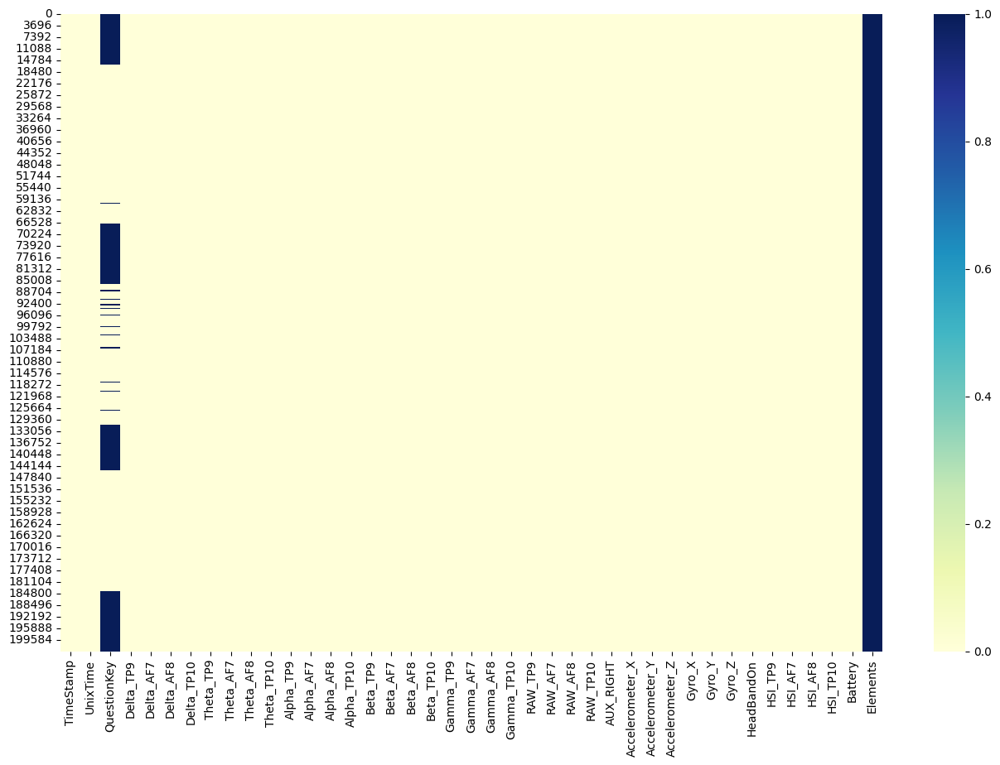

In [11]:
plt.figure(figsize=(16,10))
sns.heatmap(df_1_EEG.isnull(), cmap='YlGnBu')
plt.show()

# Notes & Observations

- We observe many **null** (or missing) values in the `QuestionKey` and `Elements` columns.  
- The nulls in the `QuestionKey` column may not represent “true” nulls. Rather, they follow interval patterns, suggesting that during those periods no question was displayed.  
- These missing values in `QuestionKey` require additional investigation and context-aware handling.  
- The `Elements` column is almost entirely null; dropping it likely won’t meaningfully impact our data quality.


In [12]:
df_1_EEG['QuestionKey'].unique()

array([nan, '1spl1', '1spl2', '1Item1', '1Item2', '1Item3', '1Item4',
       '1Item5', '1Item6', '1Item7', '1Item8', '1Item9', '1Item10',
       '2spl1', '2spl2', '2Item1', '2Item2', '2Item3', '2Item4', '2Item5',
       '2Item6', '2Item7', '2Item8', '2Item9', '2Item10', '3spl1',
       '3spl2', '3Item15', '3Item2', '3Item5', '3Item12', '3Item6',
       '3Item8', '3Item7', '3Item9', '3Item17', '3Item19', '3Item11',
       '3Item4', '3Item13', '3Item10'], dtype=object)

In [13]:
df_1_EEG['TimeStamp'] = pd.to_datetime(df_1_EEG['TimeStamp'])

In [14]:
df_1_EEG.describe()

,TimeStamp,UnixTime,Delta_TP9,Delta_AF7,Delta_AF8,Delta_TP10,Theta_TP9,Theta_AF7,Theta_AF8,Theta_TP10,Alpha_TP9,Alpha_AF7,Alpha_AF8,Alpha_TP10,Beta_TP9,Beta_AF7,Beta_AF8,Beta_TP10,Gamma_TP9,Gamma_AF7,Gamma_AF8,Gamma_TP10,RAW_TP9,RAW_AF7,RAW_AF8,RAW_TP10,AUX_RIGHT,Accelerometer_X,Accelerometer_Y,Accelerometer_Z,Gyro_X,Gyro_Y,Gyro_Z,HeadBandOn,HSI_TP9,HSI_AF7,HSI_AF8,HSI_TP10,Battery
count,203240,2.032400e+05,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.0,203228.000000,203228.0,203228.0,203228.000000,203228.000000
mean,2023-03-28 17:08:49.490545664,1.680004e+09,0.833664,0.574739,0.789598,1.086531,0.703385,0.206121,0.397564,0.850763,0.989821,0.271047,0.458978,1.095755,0.555131,-0.292869,-0.103949,1.348579,-0.152415,-0.848311,-0.538437,1.191014,853.527787,853.389643,853.245500,826.393312,849.971734,-0.037907,0.154057,0.997148,-0.585965,2.591601,4.199639,1.0,1.001678,1.0,1.0,1.040614,92.367918
min,2023-03-28 17:03:16.773000,1.680003e+09,-0.352964,-0.944335,-0.765666,0.075178,-0.092396,-0.815510,-0.788269,0.025930,0.234781,-0.526948,-0.556878,0.083386,0.173331,-0.734581,-0.597961,0.224495,-0.580597,-1.284935,-1.086768,-0.270874,633.406600,795.384640,769.597050,0.000000,737.765560,-0.118530,0.103394,0.974304,-9.637604,-7.514191,-6.504822,1.0,1.000000,1.0,1.0,1.000000,91.750000
25%,2023-03-28 17:06:03.066749952,1.680003e+09,0.543776,0.272695,0.413677,0.866665,0.500277,-0.065439,0.041976,0.751718,0.837264,0.057233,0.188926,0.961071,0.472232,-0.392938,-0.232664,1.281918,-0.239790,-0.959933,-0.738004,1.123500,845.750900,849.780200,849.780200,798.608030,833.663000,-0.044800,0.149780,0.995972,-0.725250,2.377625,3.955231,1.0,1.000000,1.0,1.0,1.000000,92.080000
50%,2023-03-28 17:08:49.463000064,1.680004e+09,0.833678,0.661015,0.888160,1.103180,0.689093,0.239495,0.468661,0.879444,0.973939,0.314013,0.527082,1.130059,0.550618,-0.311172,-0.120958,1.340619,-0.159399,-0.887617,-0.617273,1.203507,854.212460,853.406600,853.809500,828.022000,849.780200,-0.036804,0.153320,0.997437,-0.590668,2.601929,4.194489,1.0,1.000000,1.0,1.0,1.000000,92.360000
75%,2023-03-28 17:11:35.899000064,1.680004e+09,1.124410,0.904497,1.201233,1.292727,0.898628,0.487794,0.744796,0.945942,1.142591,0.475381,0.722935,1.253985,0.631174,-0.227109,-0.004970,1.444521,-0.082105,-0.794766,-0.382253,1.264943,863.076900,856.630070,857.435900,854.615360,866.300350,-0.028809,0.157593,0.998596,-0.456085,2.818756,4.448700,1.0,1.000000,1.0,1.0,1.000000,92.670000
max,2023-03-28 17:14:22.343000,1.680004e+09,1.855107,1.535837,1.755077,2.379271,1.488185,1.090289,1.247833,1.378394,1.476960,1.074470,1.165765,1.561038,1.262311,1.066372,0.961497,1.615214,0.760066,0.600935,0.741850,1.482298,979.120850,923.919430,928.351600,1650.000000,953.736270,0.032166,0.242920,1.031738,13.525543,12.247009,15.424652,1.0,2.000000,1.0,1.0,4.000000,92.980000
std,NaN,1.921824e+02,0.378599,0.432961,0.501507,0.362664,0.269127,0.356779,0.419995,0.194771,0.213066,0.279268,0.326024,0.218404,0.126553,0.176215,0.198010,0.111678,0.143173,0.228263,0.280585,0.121856,19.238645,8.634197,10.658027,111.307800,24.375990,0.012828,0.006637,0.002572,0.495968,0.520155,0.654154,0.0,0.040928,0.0,0.0,0.320985,0.352973


In [15]:
df_1_EEG.head(3)

,TimeStamp,UnixTime,QuestionKey,Delta_TP9,Delta_AF7,Delta_AF8,Delta_TP10,Theta_TP9,Theta_AF7,Theta_AF8,Theta_TP10,Alpha_TP9,Alpha_AF7,Alpha_AF8,Alpha_TP10,Beta_TP9,Beta_AF7,Beta_AF8,Beta_TP10,Gamma_TP9,Gamma_AF7,Gamma_AF8,Gamma_TP10,RAW_TP9,RAW_AF7,RAW_AF8,RAW_TP10,AUX_RIGHT,Accelerometer_X,Accelerometer_Y,Accelerometer_Z,Gyro_X,Gyro_Y,Gyro_Z,HeadBandOn,HSI_TP9,HSI_AF7,HSI_AF8,HSI_TP10,Battery,Elements
0,2023-03-28 17:03:16.773,1.680003e+09,NaN,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.164987,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,845.34796,852.19780,852.19780,1209.1941,824.3956,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,1.0,2.0,92.98,NaN
1,2023-03-28 17:03:16.776,1.680003e+09,NaN,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.164987,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,851.39197,850.18317,854.21246,1202.3444,850.9890,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,1.0,2.0,92.98,NaN
2,2023-03-28 17:03:16.778,1.680003e+09,NaN,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.164987,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,843.73627,848.57140,857.43590,1163.2601,857.8388,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,1.0,2.0,92.98,NaN


In [16]:
df_1_EEG.drop('Elements', axis=1, inplace=True)

In [17]:
df_1_EEG['QuestionKey'].unique()

array([nan, '1spl1', '1spl2', '1Item1', '1Item2', '1Item3', '1Item4',
       '1Item5', '1Item6', '1Item7', '1Item8', '1Item9', '1Item10',
       '2spl1', '2spl2', '2Item1', '2Item2', '2Item3', '2Item4', '2Item5',
       '2Item6', '2Item7', '2Item8', '2Item9', '2Item10', '3spl1',
       '3spl2', '3Item15', '3Item2', '3Item5', '3Item12', '3Item6',
       '3Item8', '3Item7', '3Item9', '3Item17', '3Item19', '3Item11',
       '3Item4', '3Item13', '3Item10'], dtype=object)

In [18]:
df_1_EEG['QuestionKey'].fillna('None', inplace=True)

/tmp/ipykernel_21004/1230879840.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_1_EEG['QuestionKey'].fillna('None', inplace=True)


In [19]:
df_1_EEG['QuestionKey'].value_counts()

QuestionKey
None       72914
2Item7     10650
1Item5      7929
3Item9      6721
1Item10     6424
2Item9      5824
1Item4      5359
1Item3      5028
1Item8      5022
2Item10     4522
1Item2      4464
3Item19     3877
2Item6      3732
3Item8      3563
2Item4      3493
3Item17     3403
3Item11     3307
1spl1       3172
3Item4      3092
1Item9      2946
1Item6      2706
1Item7      2706
2Item8      2587
3Item15     2483
3Item12     2454
1spl2       2411
3Item13     2360
1Item1      2337
2spl2       2301
2Item5      2280
3Item7      2048
2spl1       1916
2Item3      1659
2Item1      1384
3Item6      1128
3spl1       1014
3Item5      1010
2Item2       935
3Item2       917
3spl2        848
3Item10      314
Name: count, dtype: int64

In [20]:
df_1_EEG['HeadBandOn'].unique()

array([ 1., nan])

In [21]:
df_1_EEG['HeadBandOn'].isnull().sum()

np.int64(12)

In [22]:
df_1_EEG.shape

(203240, 40)

In [23]:
df_1_EEG.dropna(inplace=True)

In [24]:
df_1_EEG.shape

(203228, 40)

In [25]:
df_1_EEG.drop('HeadBandOn', axis=1, inplace=True)

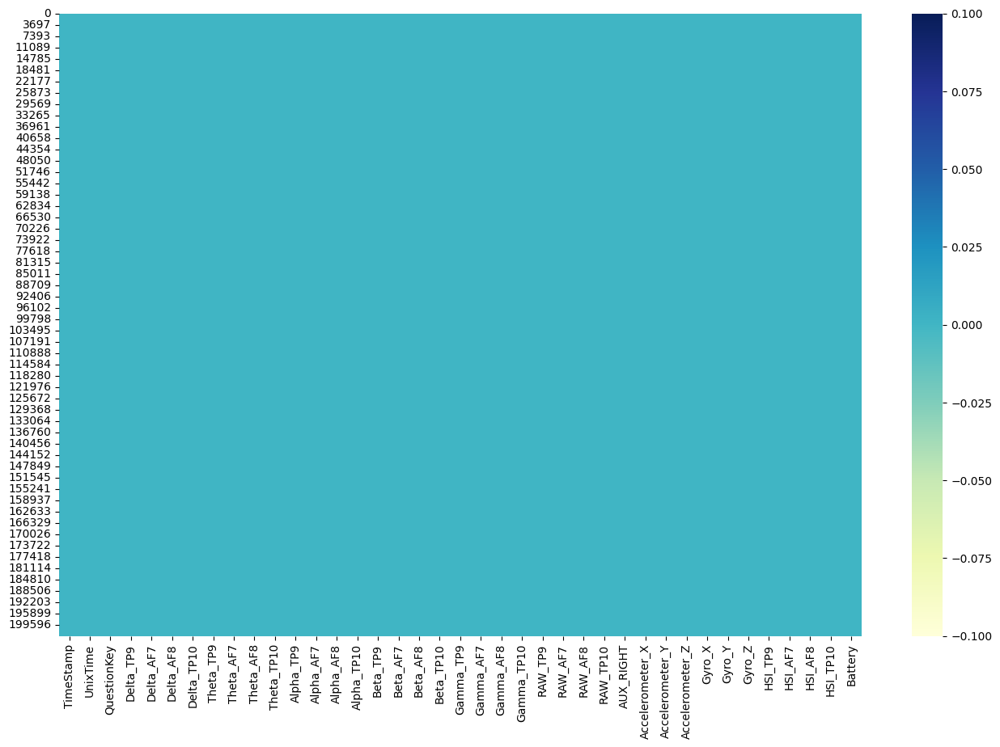

In [26]:
plt.figure(figsize=(16,10))
sns.heatmap(df_1_EEG.isnull(), cmap='YlGnBu')
plt.show()

## Status Update

- All **null** (or missing) values in the dataset have been handled / eliminated.
- There are no remaining null values in any column.
- The dataset is now “complete” in the sense that every cell has a valid (non-null) entry.


In [27]:
df_1_EEG.columns

Index(['TimeStamp', 'UnixTime', 'QuestionKey', 'Delta_TP9', 'Delta_AF7',
       'Delta_AF8', 'Delta_TP10', 'Theta_TP9', 'Theta_AF7', 'Theta_AF8',
       'Theta_TP10', 'Alpha_TP9', 'Alpha_AF7', 'Alpha_AF8', 'Alpha_TP10',
       'Beta_TP9', 'Beta_AF7', 'Beta_AF8', 'Beta_TP10', 'Gamma_TP9',
       'Gamma_AF7', 'Gamma_AF8', 'Gamma_TP10', 'RAW_TP9', 'RAW_AF7', 'RAW_AF8',
       'RAW_TP10', 'AUX_RIGHT', 'Accelerometer_X', 'Accelerometer_Y',
       'Accelerometer_Z', 'Gyro_X', 'Gyro_Y', 'Gyro_Z', 'HSI_TP9', 'HSI_AF7',
       'HSI_AF8', 'HSI_TP10', 'Battery'],
      dtype='object')

In [28]:
cols = ['Delta_TP9', 'Delta_AF7',
       'Delta_AF8', 'Delta_TP10', 'Theta_TP9', 'Theta_AF7', 'Theta_AF8',
       'Theta_TP10', 'Alpha_TP9', 'Alpha_AF7', 'Alpha_AF8', 'Alpha_TP10',
       'Beta_TP9', 'Beta_AF7', 'Beta_AF8', 'Beta_TP10', 'Gamma_TP9',
       'Gamma_AF7', 'Gamma_AF8', 'Gamma_TP10', 'RAW_TP9', 'RAW_AF7', 'RAW_AF8',
       'RAW_TP10', 'AUX_RIGHT', 'Accelerometer_X', 'Accelerometer_Y',
       'Accelerometer_Z', 'Gyro_X', 'Gyro_Y', 'Gyro_Z',
       'HSI_TP9', 'HSI_AF7', 'HSI_AF8', 'HSI_TP10', 'Battery']

In [29]:
# from IPython.display import display, Markdown

# canvas = ds.Canvas(plot_width=1000, plot_height=600)

# for col in cols:
#     # Add a markdown cell before each plot for better separation and labeling
#     display(Markdown(f'### {col} over Time'))
#     agg = canvas.line(df_1_EEG, x='UnixTime', y=col)
#     img = tf.shade(agg)
#     plt.figure(figsize=(16, 10))
#     plt.imshow(img.to_pil())
#     # plt.axis('off')  # Removed this line to show axes
#     plt.xlabel("UnixTime") # Add x-axis label
#     plt.ylabel(col) # Add y-axis label
#     plt.show()

### Delta_TP9 over Time

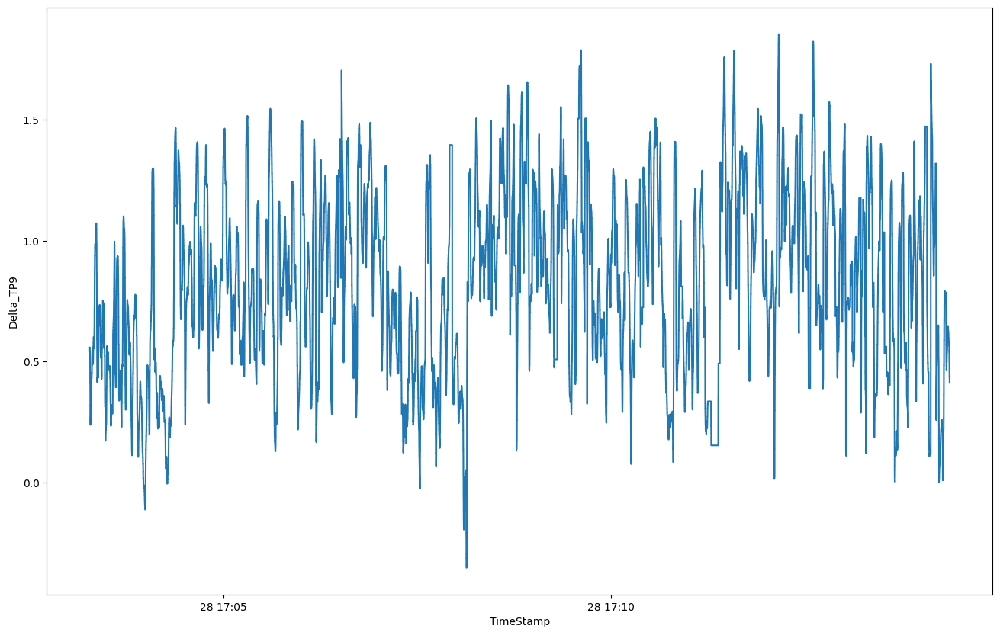

### Delta_AF7 over Time

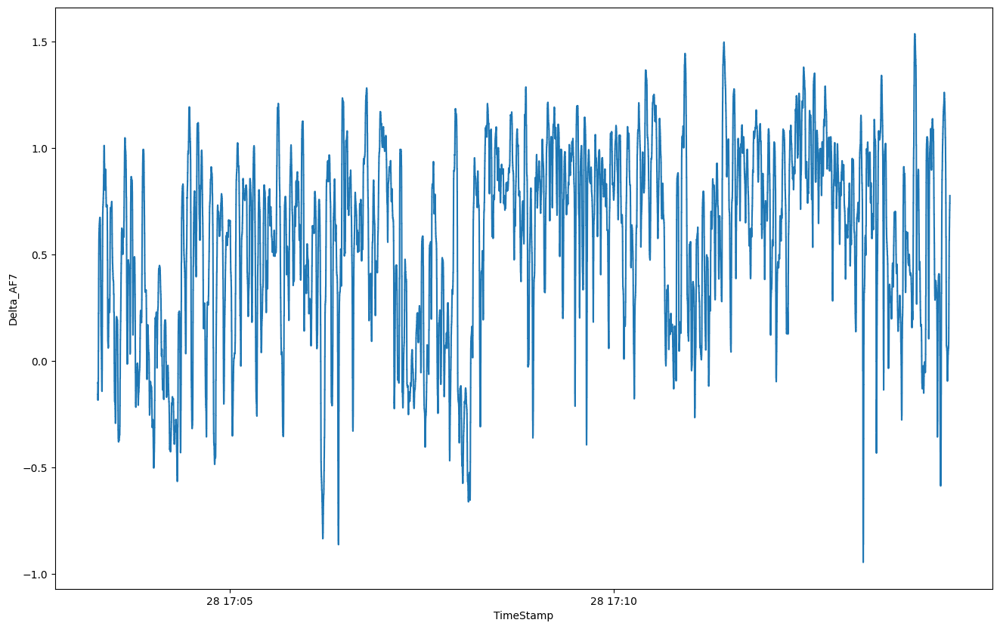

### Delta_AF8 over Time

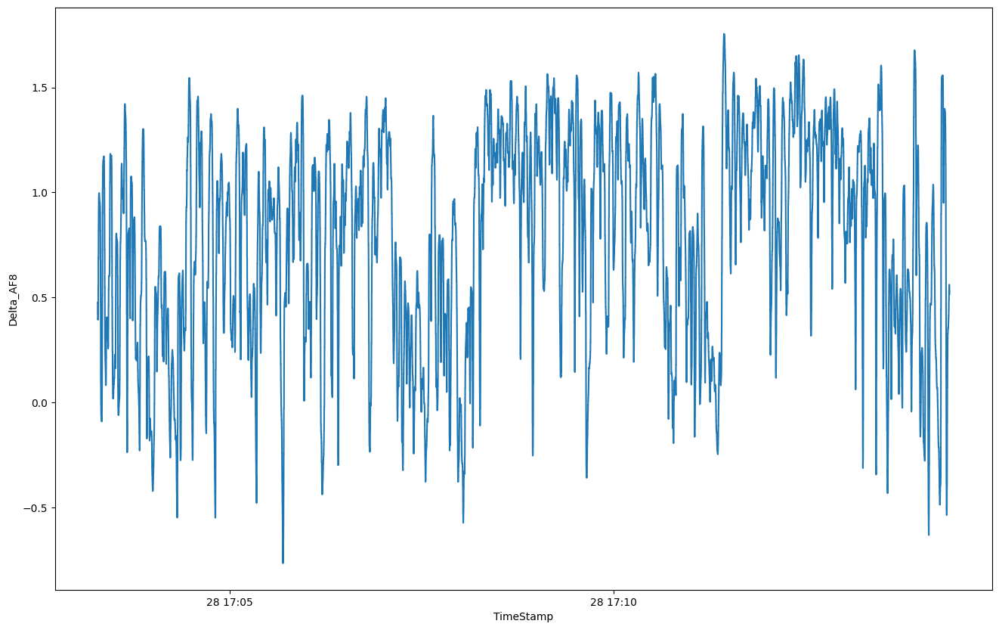

### Delta_TP10 over Time

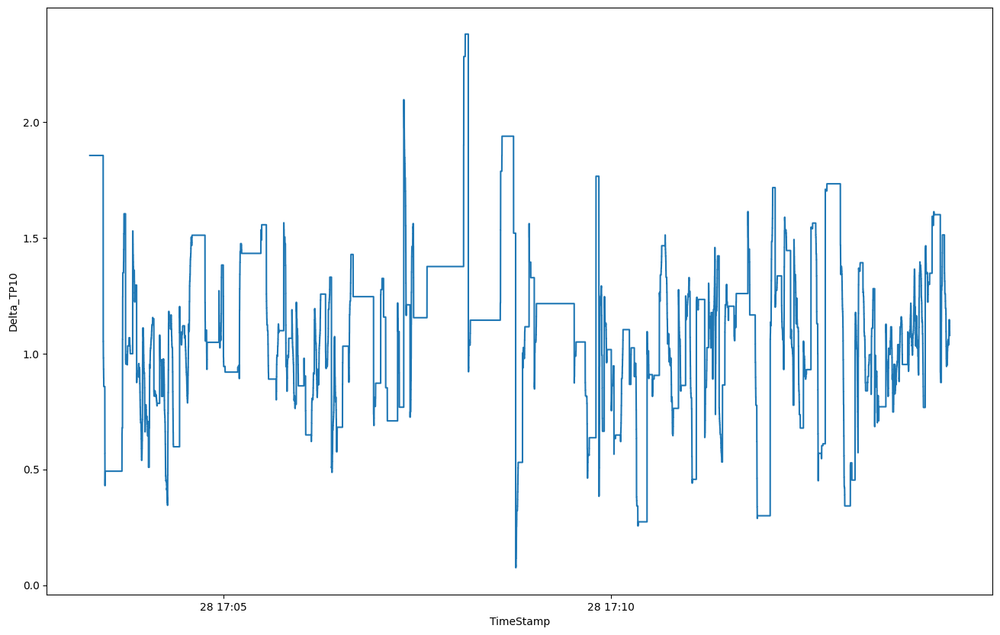

### Theta_TP9 over Time

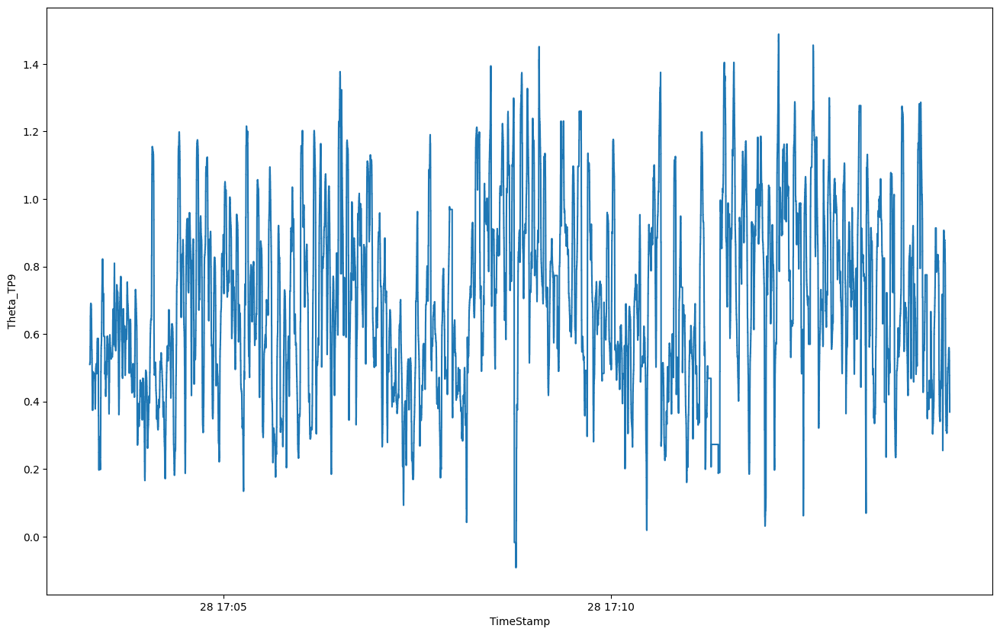

### Theta_AF7 over Time

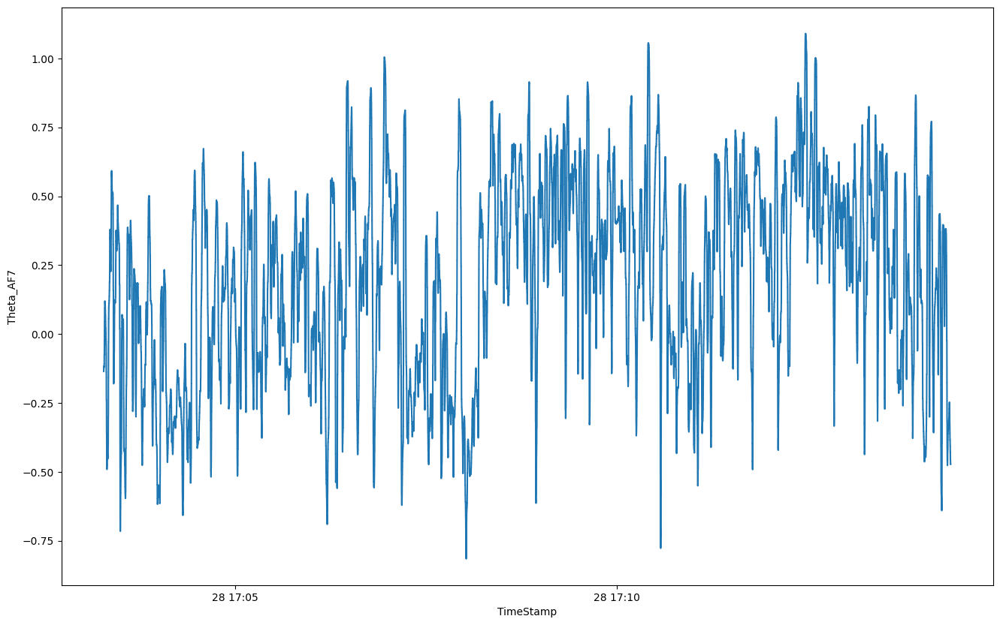

### Theta_AF8 over Time

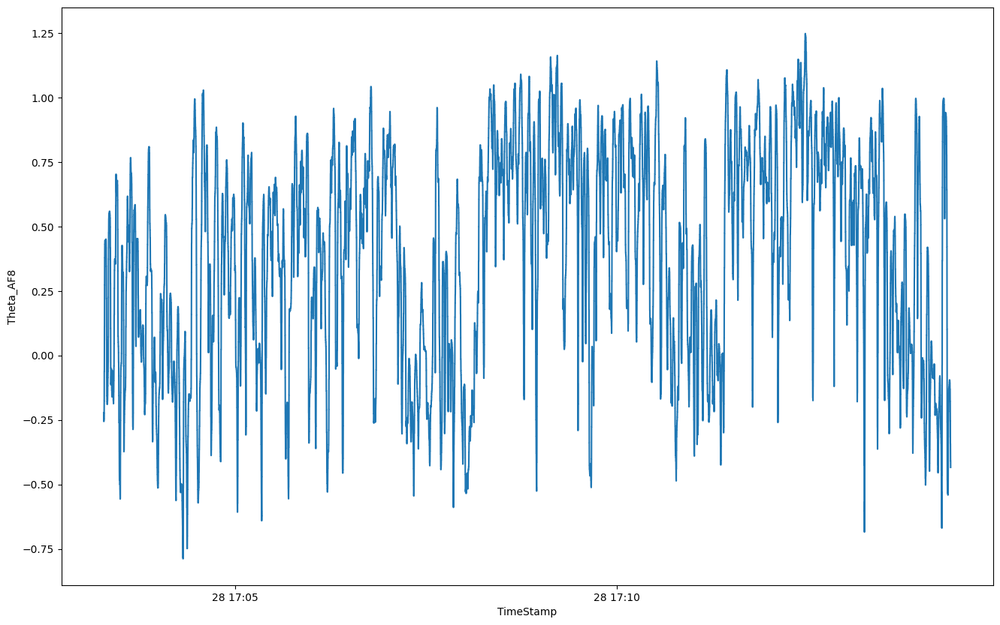

### Theta_TP10 over Time

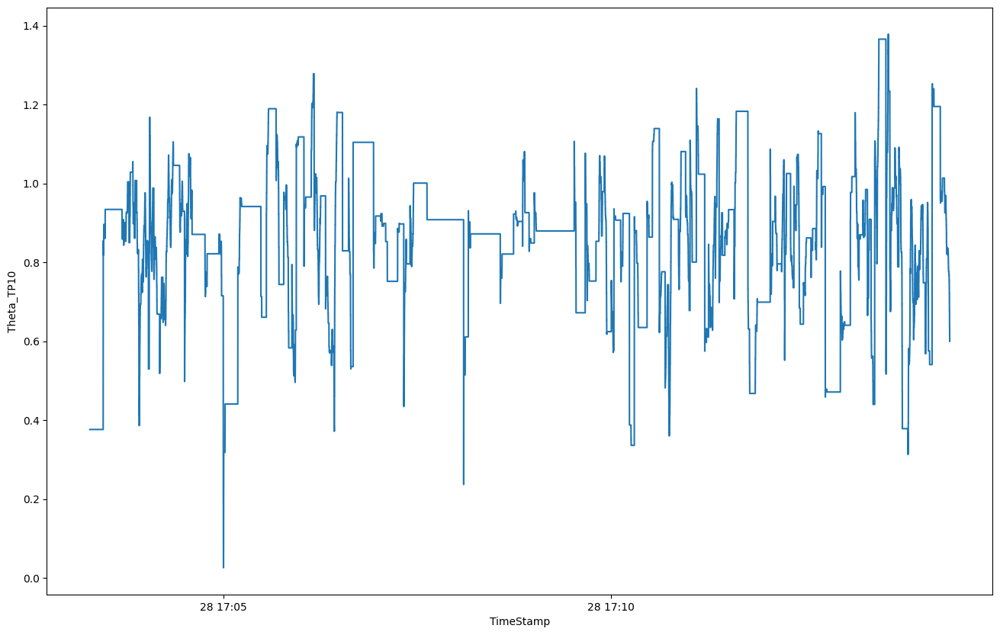

### Alpha_TP9 over Time

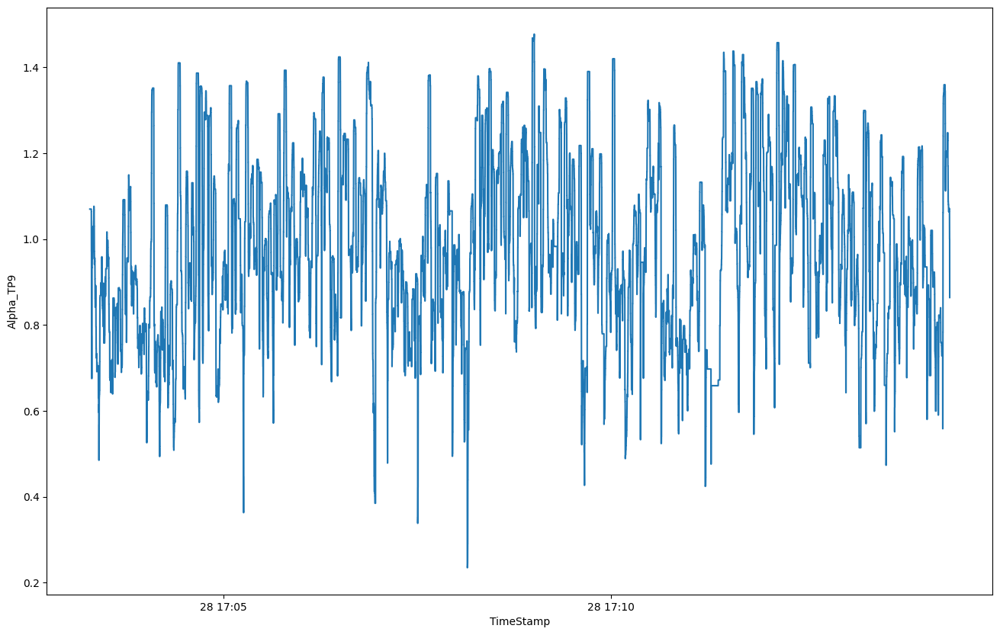

### Alpha_AF7 over Time

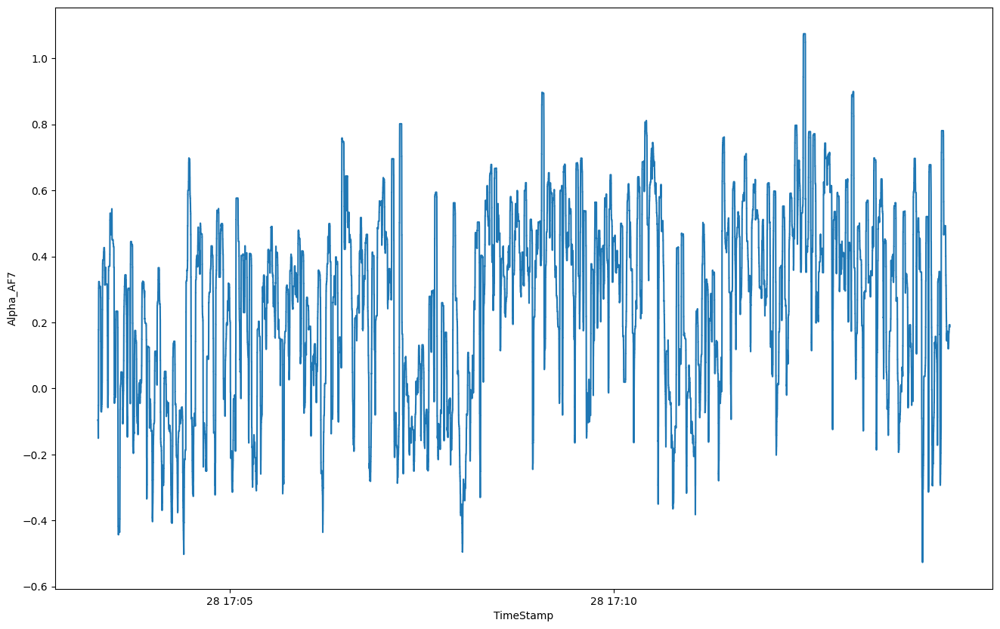

### Alpha_AF8 over Time

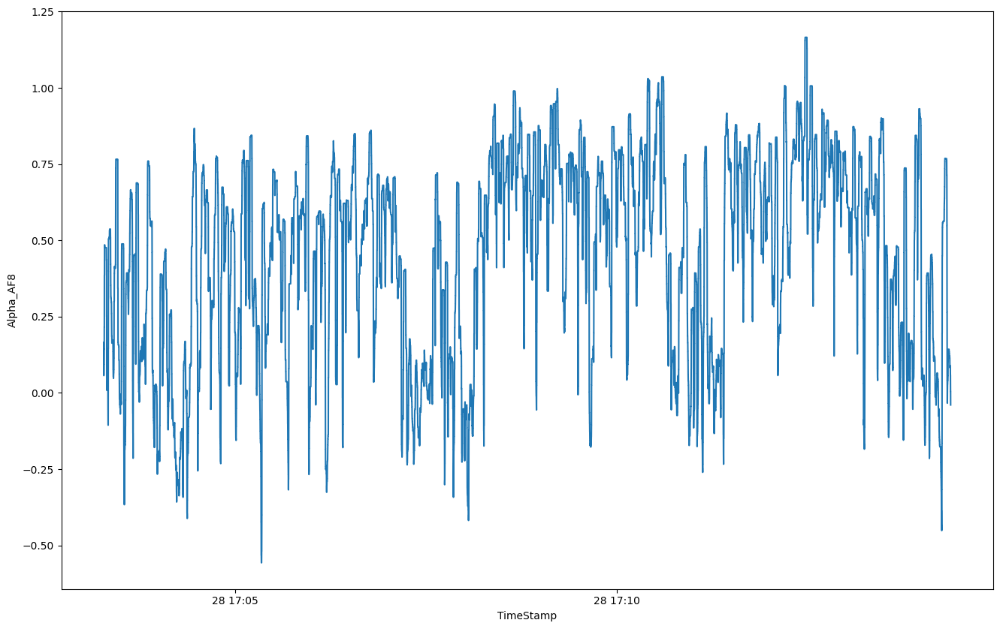

### Alpha_TP10 over Time

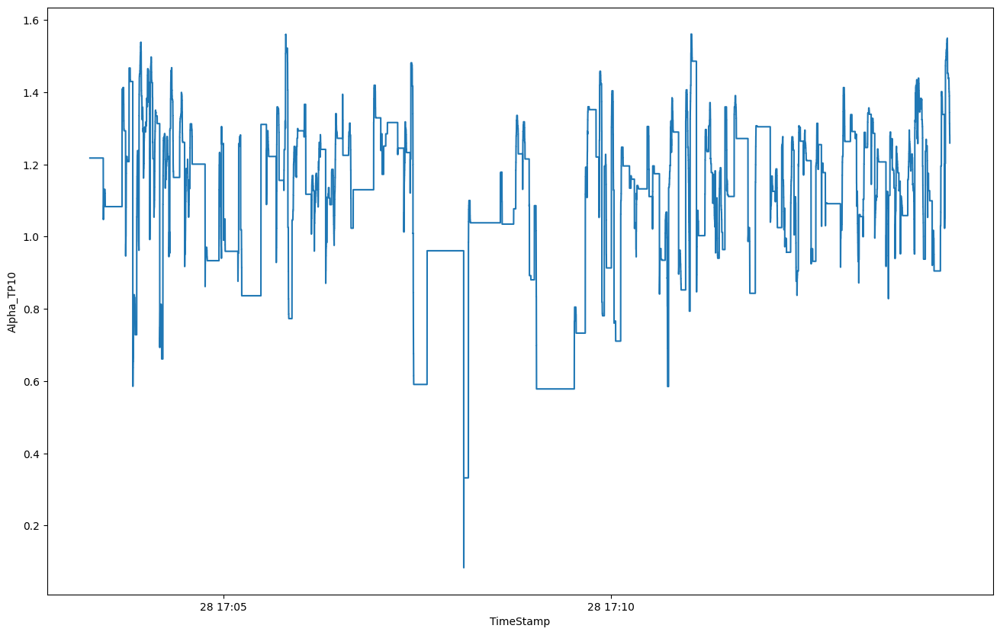

### Beta_TP9 over Time

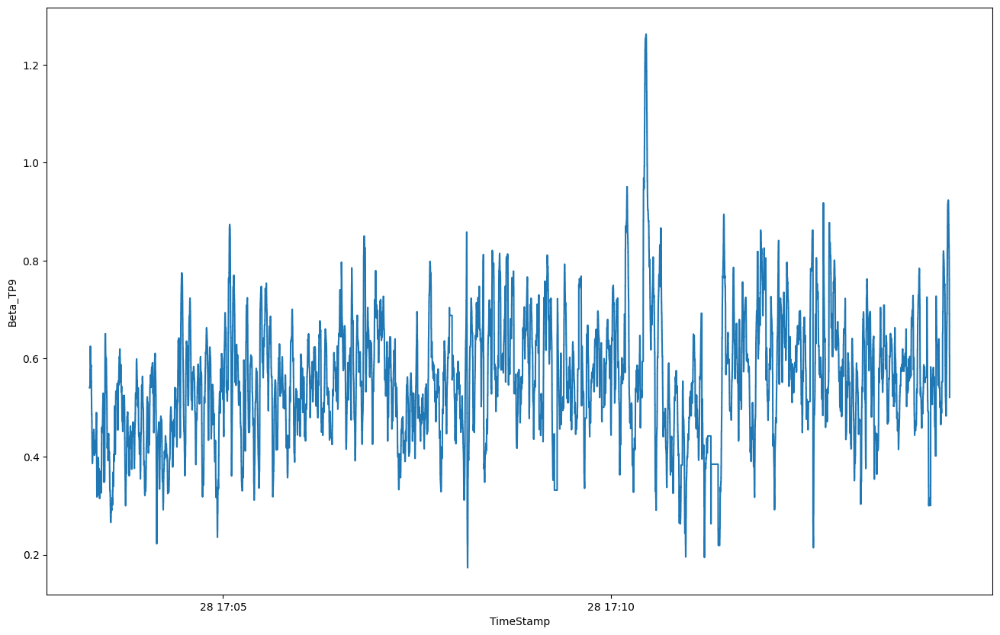

### Beta_AF7 over Time

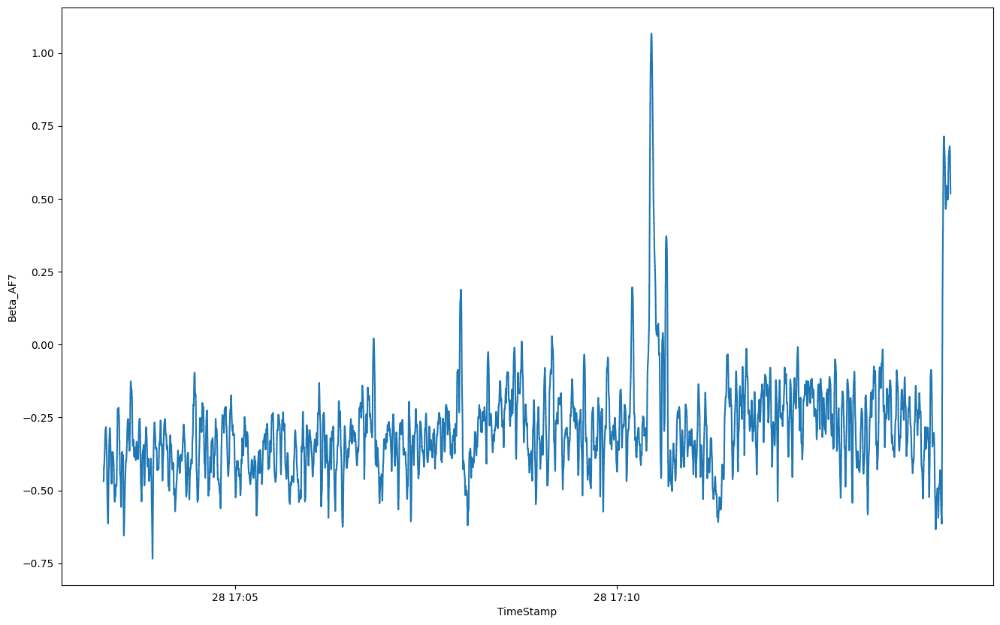

### Beta_AF8 over Time

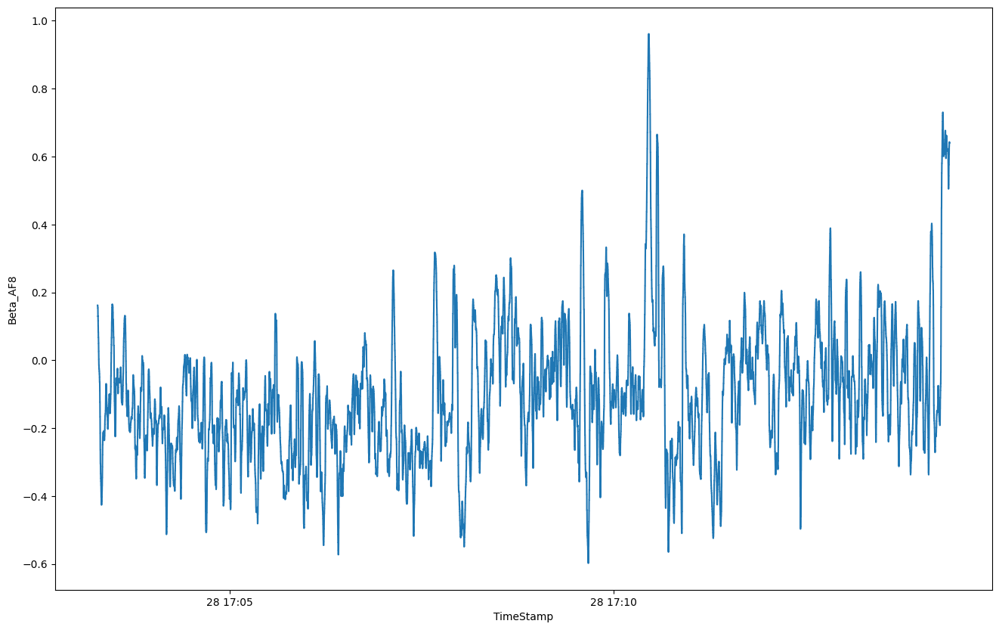

### Beta_TP10 over Time

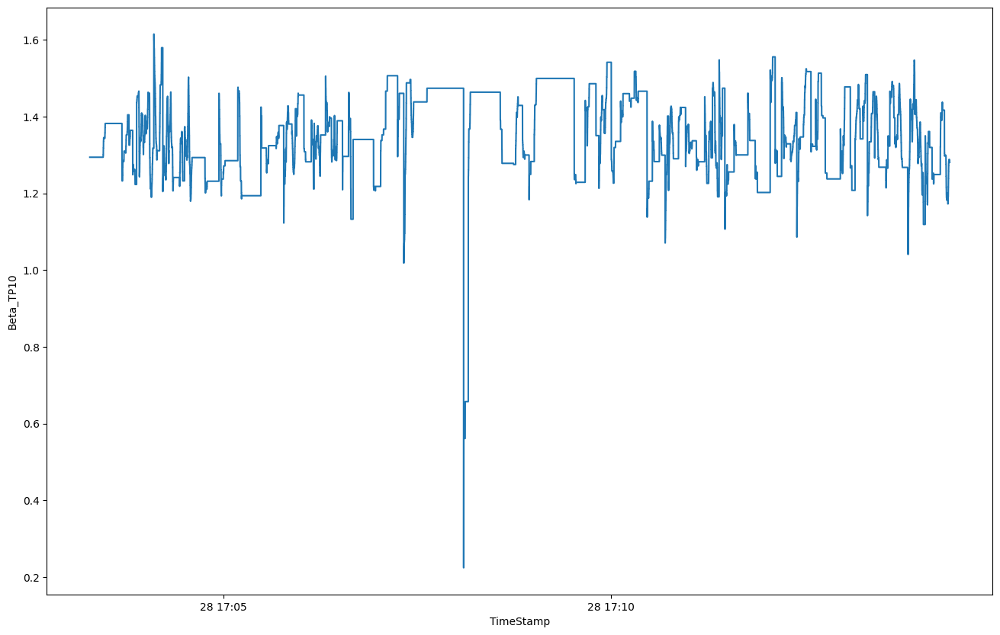

### Gamma_TP9 over Time

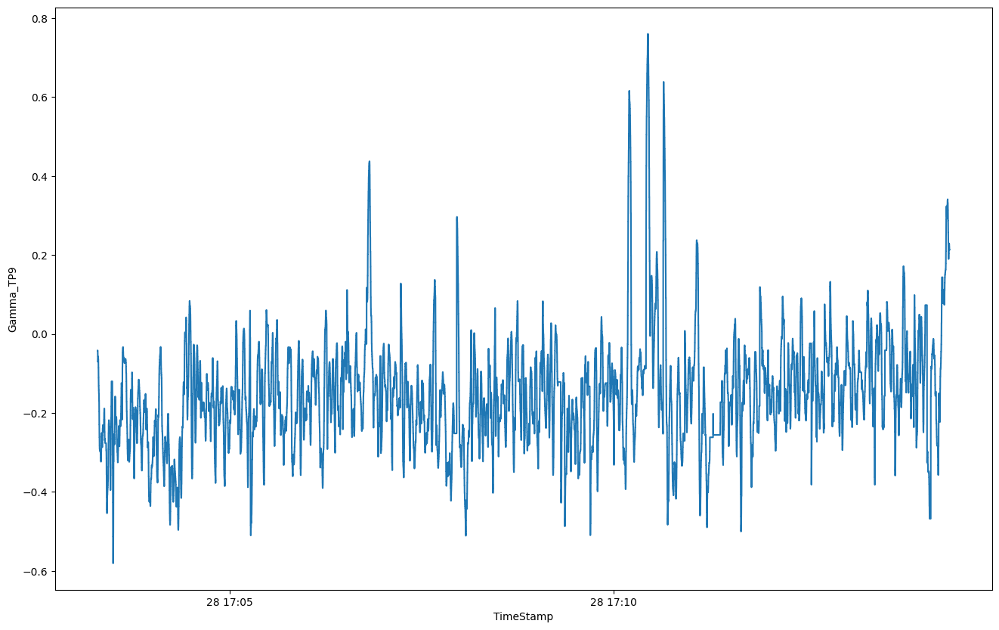

### Gamma_AF7 over Time

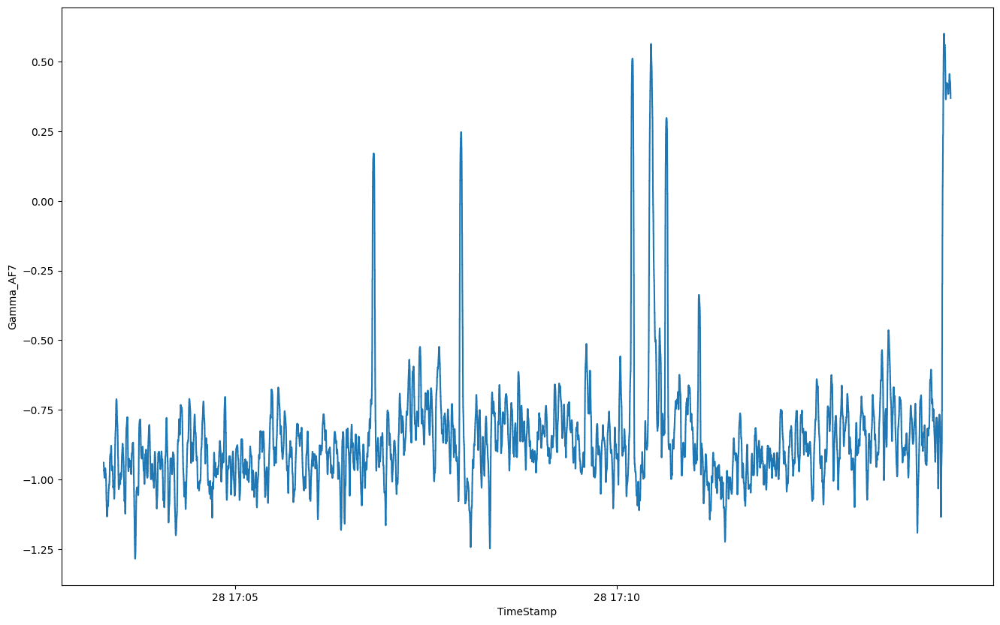

### Gamma_AF8 over Time

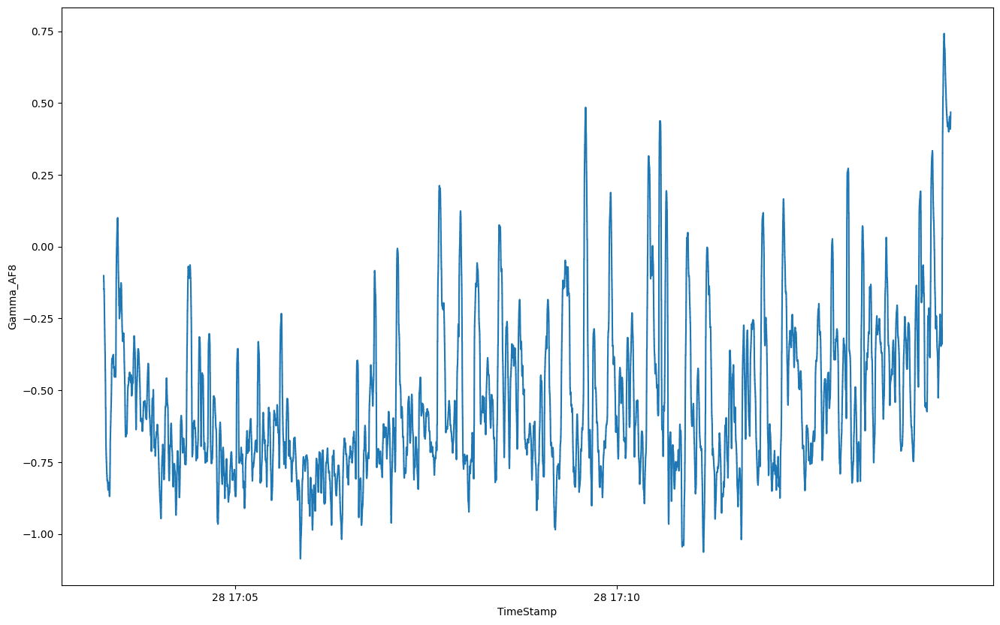

### Gamma_TP10 over Time

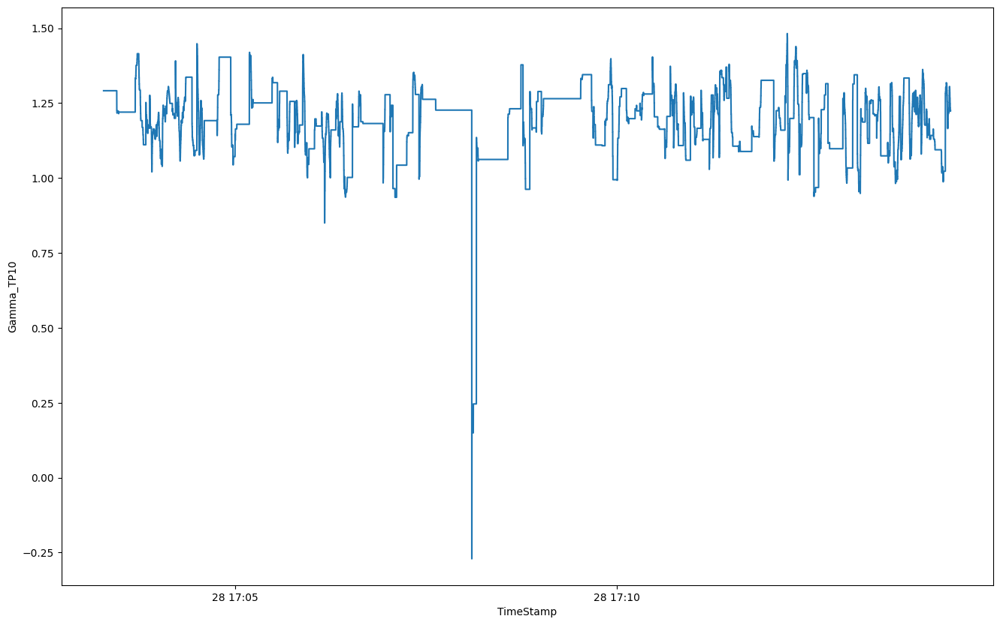

### RAW_TP9 over Time

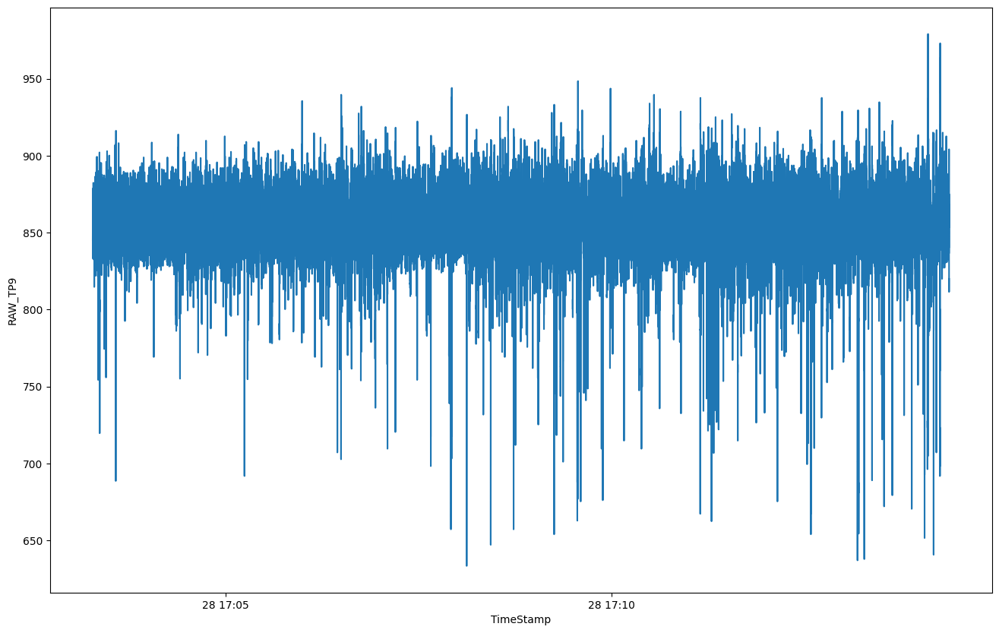

### RAW_AF7 over Time

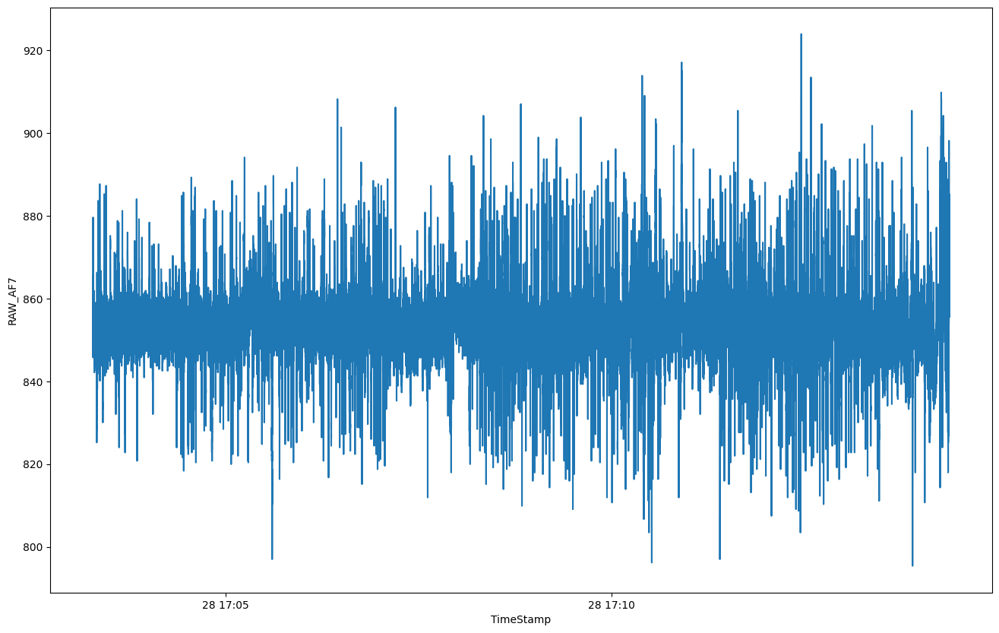

### RAW_AF8 over Time

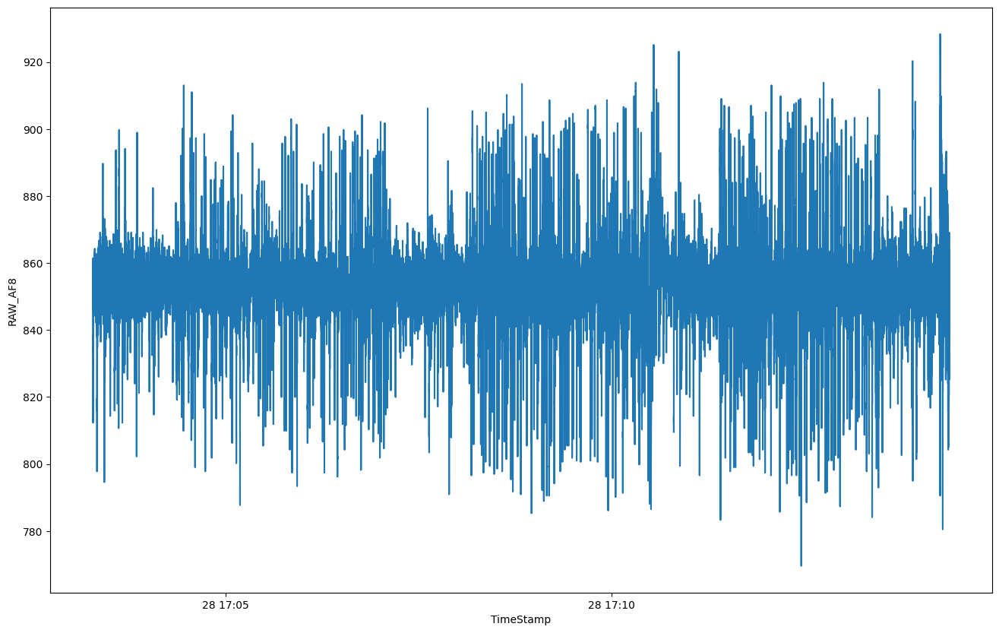

### RAW_TP10 over Time

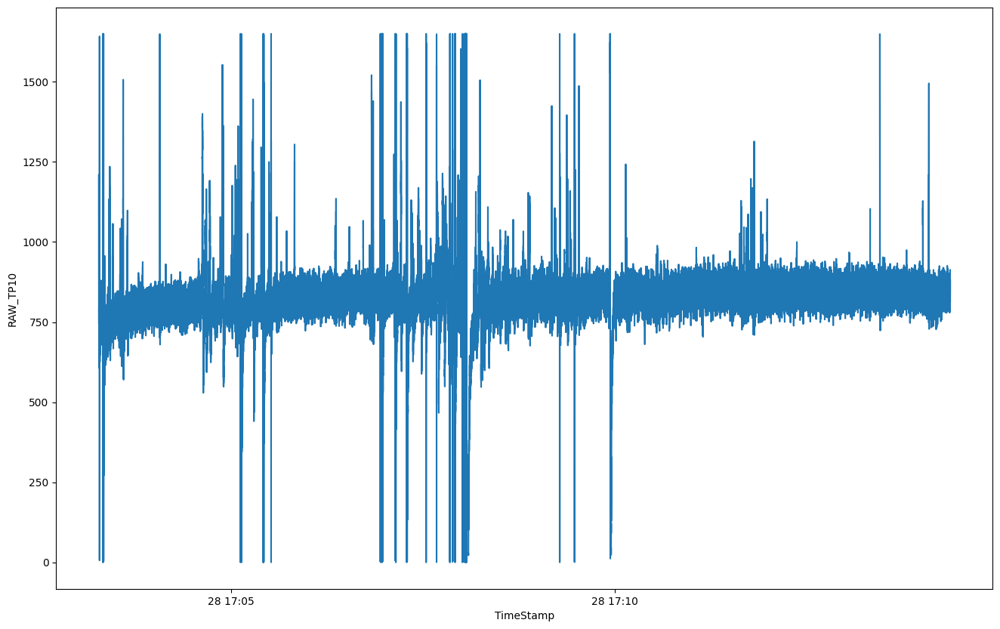

### AUX_RIGHT over Time

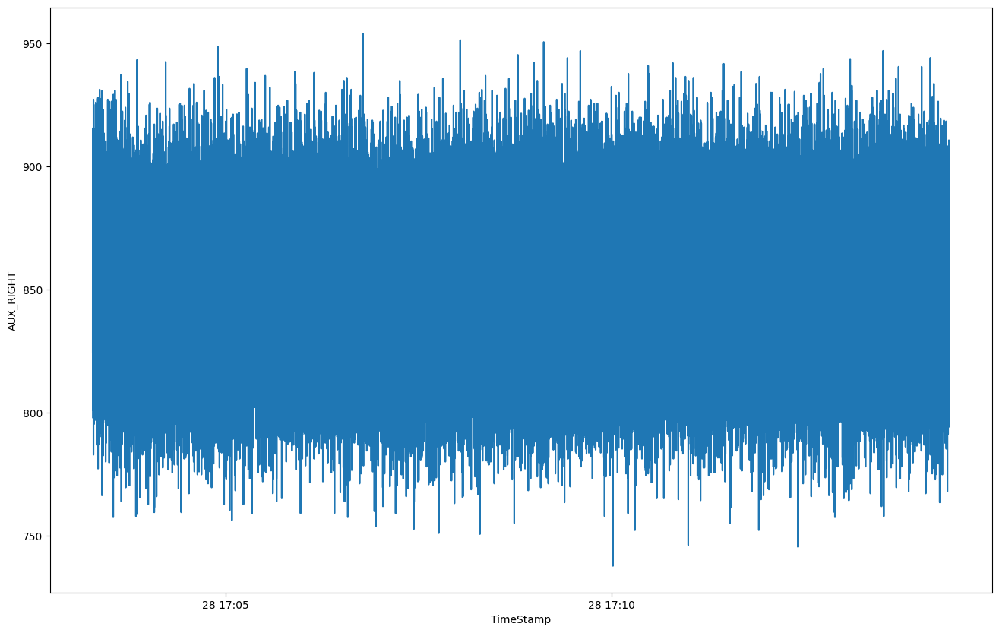

### Accelerometer_X over Time

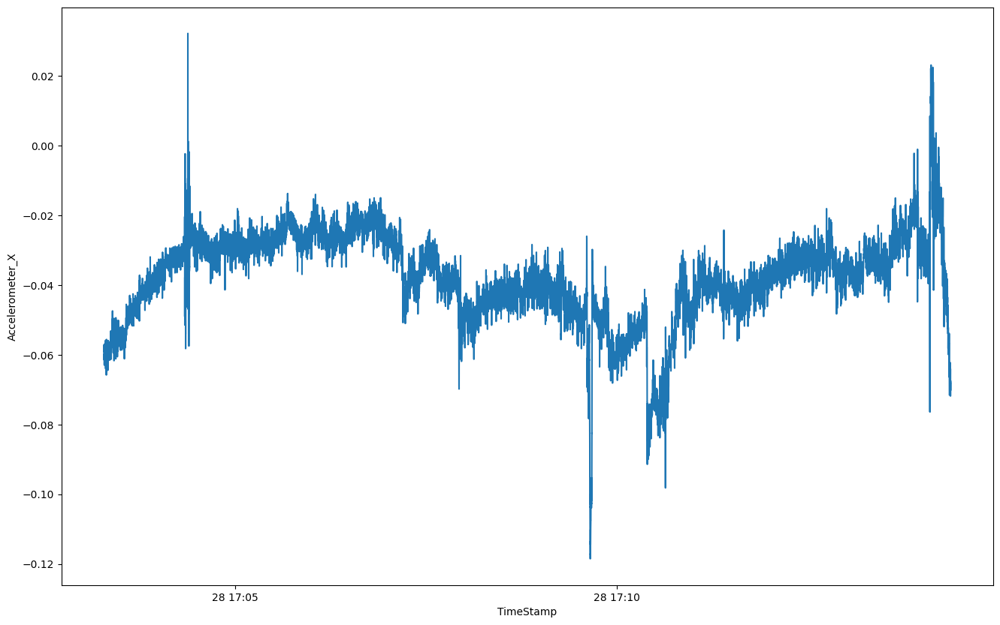

### Accelerometer_Y over Time

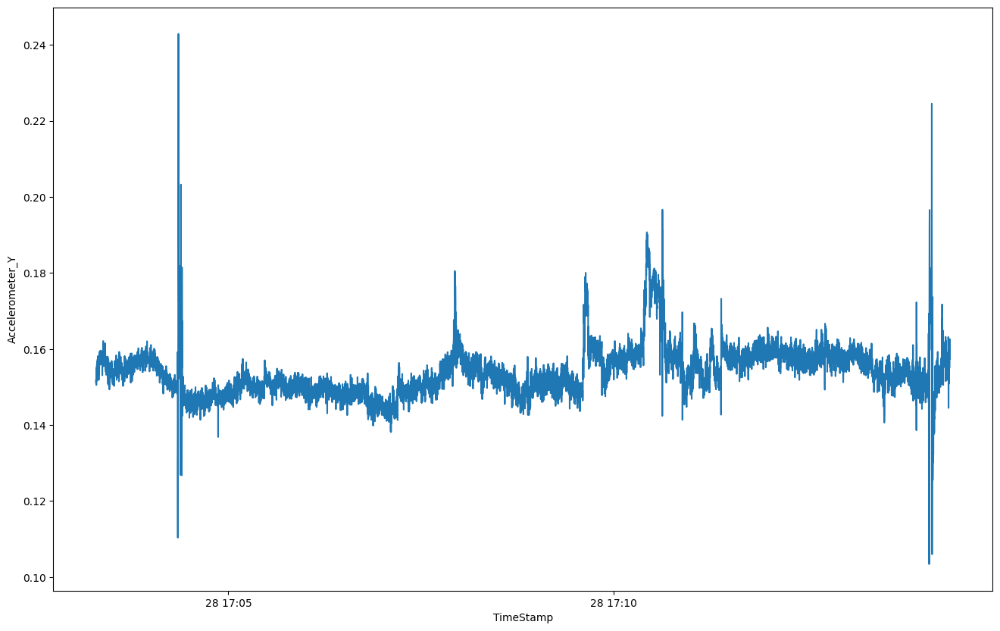

### Accelerometer_Z over Time

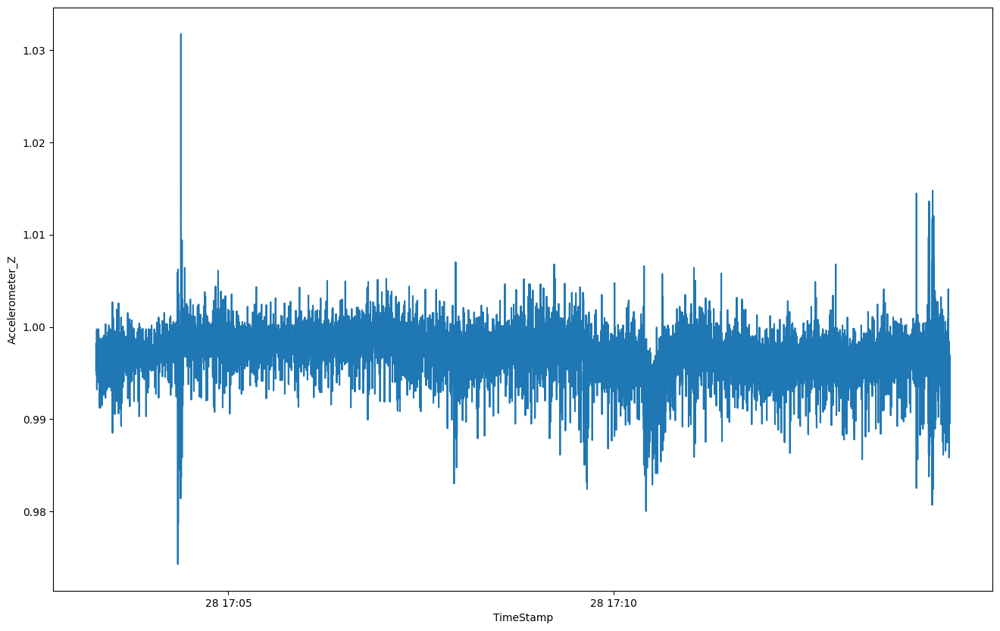

### Gyro_X over Time

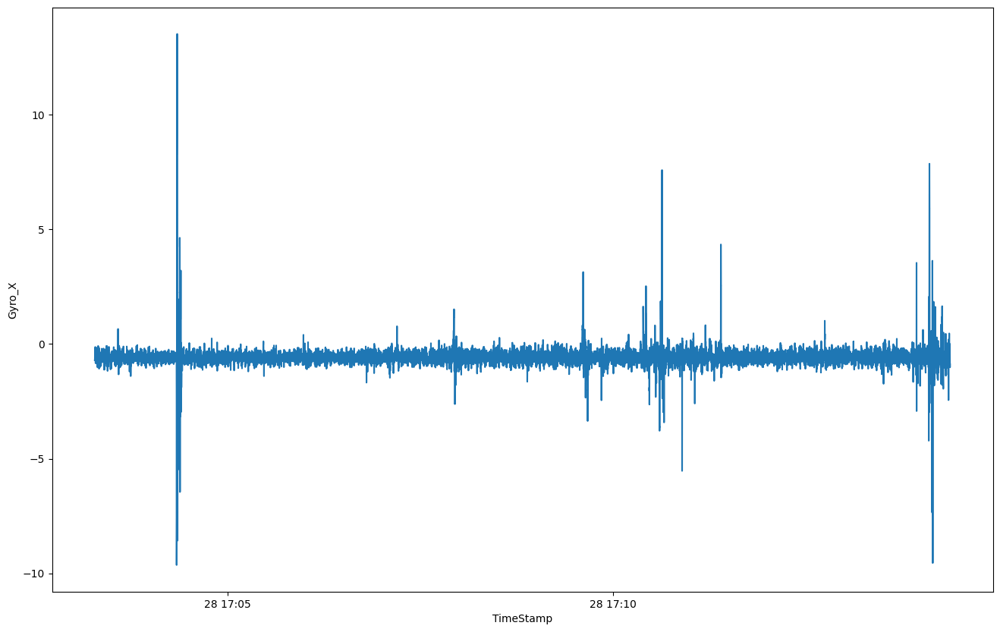

### Gyro_Y over Time

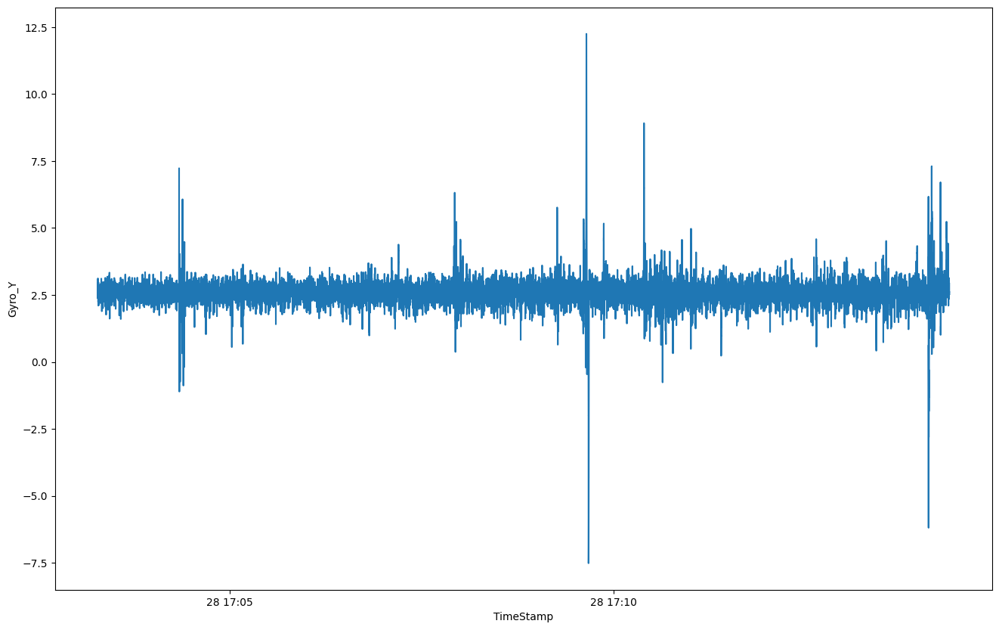

### Gyro_Z over Time

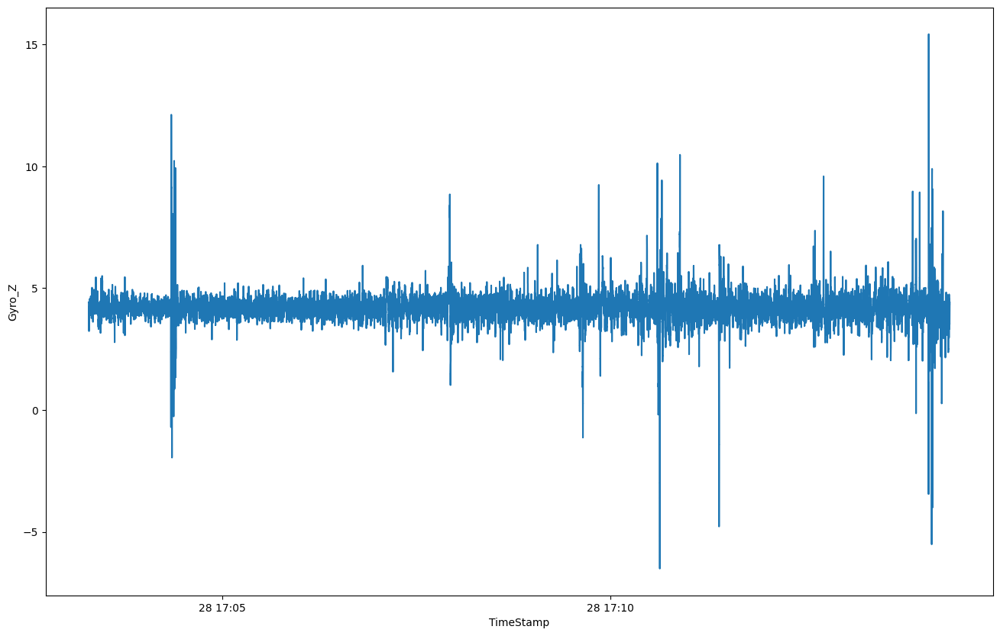

### HSI_TP9 over Time

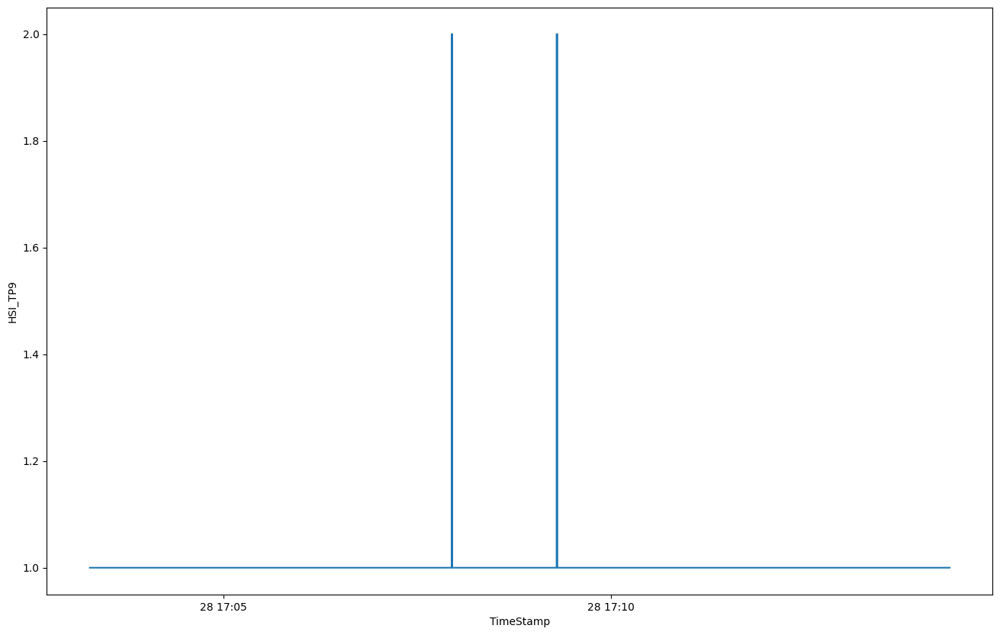

### HSI_AF7 over Time

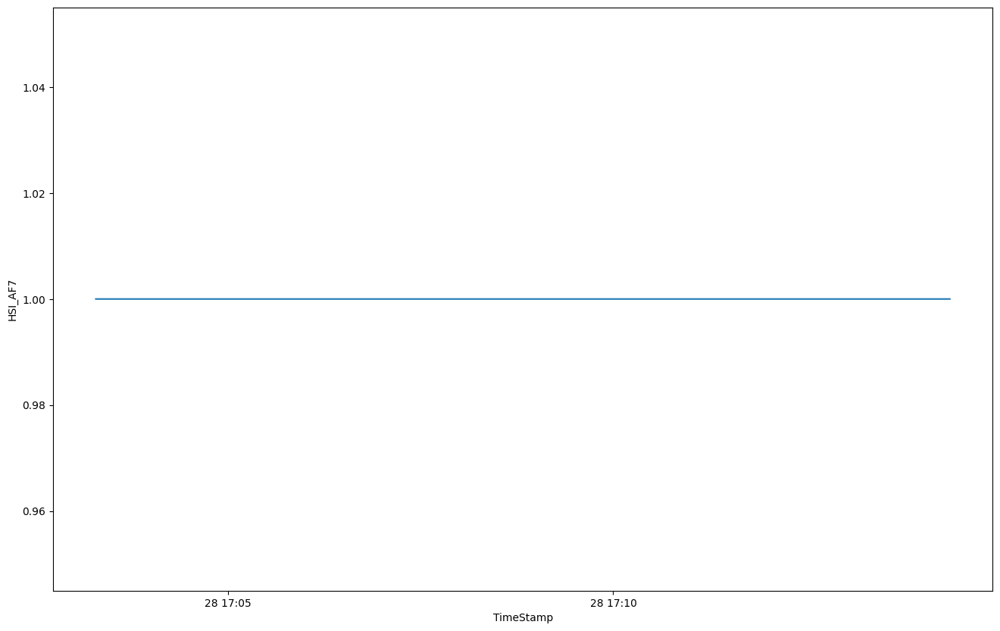

### HSI_AF8 over Time

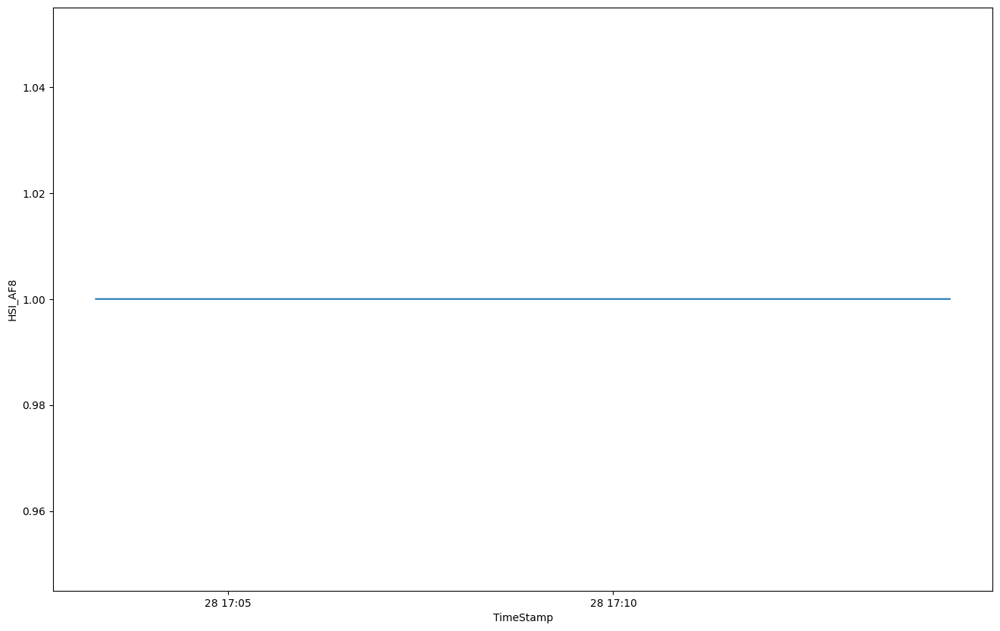

### HSI_TP10 over Time

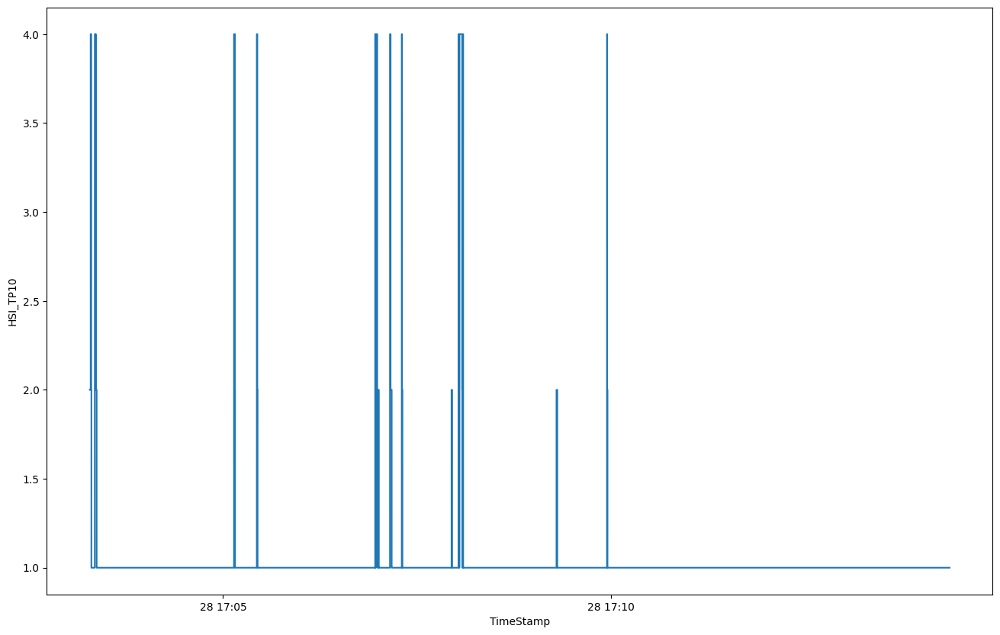

### Battery over Time

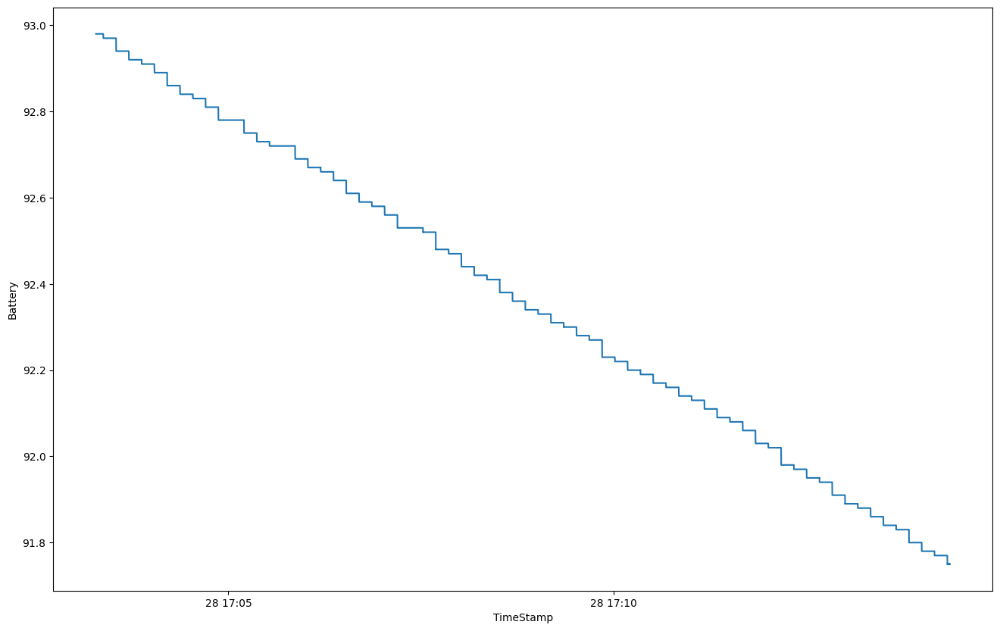

In [30]:
from IPython.display import display, Markdown


for col in cols:
    # Add a markdown cell before each plot for better separation and labeling
    display(Markdown(f'### {col} over Time'))
    plt.figure(figsize=(16, 10))
    plt.plot(df_1_EEG['TimeStamp'], df_1_EEG[col])
    plt.xlabel("TimeStamp") # Add x-axis label
    plt.ylabel(col) # Add y-axis label
    plt.show()

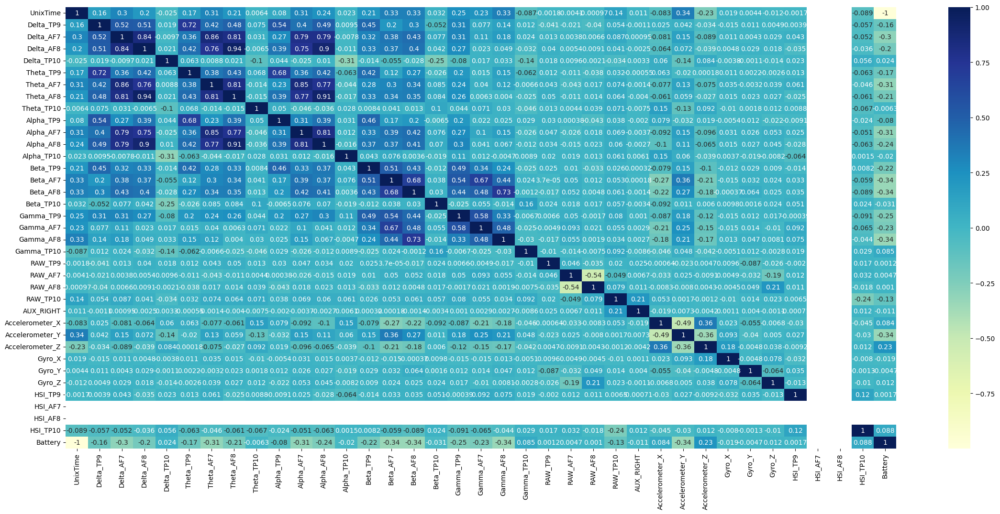

In [31]:
plt.figure(figsize=(28,12))
sns.heatmap(df_1_EEG.corr(numeric_only=True), cmap='YlGnBu', annot=True)
plt.show()

## Notes & Observations

### Dropping `AUX_RIGHT`
- The `AUX_RIGHT` channel comes from the auxiliary electrode input of the EEG headset.  
- Upon inspection, its values appeared as **flat high-amplitude noise** (750–950 range) without any meaningful oscillatory EEG patterns.  
- Correlation analysis also showed **no significant relationship** between `AUX_RIGHT` and other EEG features.  
- Since it does not carry useful information and only adds noise/dimensionality, we **dropped `AUX_RIGHT`** from the dataset.




In [32]:
df_1_EEG.drop('AUX_RIGHT', axis=1, inplace=True)

In [33]:
df_1_EEG.head()

,TimeStamp,UnixTime,QuestionKey,Delta_TP9,Delta_AF7,Delta_AF8,Delta_TP10,Theta_TP9,Theta_AF7,Theta_AF8,Theta_TP10,Alpha_TP9,Alpha_AF7,Alpha_AF8,Alpha_TP10,Beta_TP9,Beta_AF7,Beta_AF8,Beta_TP10,Gamma_TP9,Gamma_AF7,Gamma_AF8,Gamma_TP10,RAW_TP9,RAW_AF7,RAW_AF8,RAW_TP10,Accelerometer_X,Accelerometer_Y,Accelerometer_Z,Gyro_X,Gyro_Y,Gyro_Z,HSI_TP9,HSI_AF7,HSI_AF8,HSI_TP10,Battery
0,2023-03-28 17:03:16.773,1.680003e+09,None,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.164987,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,845.34796,852.19780,852.19780,1209.1941,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,2.0,92.98
1,2023-03-28 17:03:16.776,1.680003e+09,None,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.164987,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,851.39197,850.18317,854.21246,1202.3444,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,2.0,92.98
2,2023-03-28 17:03:16.778,1.680003e+09,None,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.164987,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,843.73627,848.57140,857.43590,1163.2601,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,2.0,92.98
3,2023-03-28 17:03:16.798,1.680003e+09,None,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.056794,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,843.73627,848.57140,857.43590,1163.2601,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,2.0,92.98
4,2023-03-28 17:03:16.801,1.680003e+09,None,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.056794,1.217834,0.544334,-0.457134,0.153899,1.294303,-0.041819,-0.939325,-0.100977,1.291504,843.73627,848.57140,857.43590,1163.2601,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,2.0,92.98


In [34]:
HSI_cols = ["HSI_TP9", "HSI_AF7", "HSI_AF8", "HSI_TP10"]

In [35]:
for col in HSI_cols:
    print(f"Unique values for {col}: {df_1_EEG[col].unique()}")

Unique values for HSI_TP9: [1. 2.]
Unique values for HSI_AF7: [1.]
Unique values for HSI_AF8: [1.]
Unique values for HSI_TP10: [2. 4. 1.]


In [36]:
df_1_EEG['HSI_TP9'].value_counts()

HSI_TP9
1.0    202887
2.0       341
Name: count, dtype: int64

In [37]:
df_1_EEG['HSI_TP10'].value_counts()

HSI_TP10
1.0    199314
4.0      2170
2.0      1744
Name: count, dtype: int64

In [38]:
df_1_EEG['HSI_AF7'].value_counts()

HSI_AF7
1.0    203228
Name: count, dtype: int64

In [39]:
df_1_EEG['HSI_AF8'].value_counts()

HSI_AF8
1.0    203228
Name: count, dtype: int64

In [41]:
df_1_EEG.describe()

,TimeStamp,UnixTime,Delta_TP9,Delta_AF7,Delta_AF8,Delta_TP10,Theta_TP9,Theta_AF7,Theta_AF8,Theta_TP10,Alpha_TP9,Alpha_AF7,Alpha_AF8,Alpha_TP10,Beta_TP9,Beta_AF7,Beta_AF8,Beta_TP10,Gamma_TP9,Gamma_AF7,Gamma_AF8,Gamma_TP10,RAW_TP9,RAW_AF7,RAW_AF8,RAW_TP10,Accelerometer_X,Accelerometer_Y,Accelerometer_Z,Gyro_X,Gyro_Y,Gyro_Z,HSI_TP9,HSI_AF7,HSI_AF8,HSI_TP10,Battery
count,203228,2.032280e+05,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.000000,203228.0,203228.0,203228.000000,203228.000000
mean,2023-03-28 17:08:49.489361152,1.680004e+09,0.833664,0.574739,0.789598,1.086531,0.703385,0.206121,0.397564,0.850763,0.989821,0.271047,0.458978,1.095755,0.555131,-0.292869,-0.103949,1.348579,-0.152415,-0.848311,-0.538437,1.191014,853.527787,853.389643,853.245500,826.393312,-0.037907,0.154057,0.997148,-0.585965,2.591601,4.199639,1.001678,1.0,1.0,1.040614,92.367918
min,2023-03-28 17:03:16.773000,1.680003e+09,-0.352964,-0.944335,-0.765666,0.075178,-0.092396,-0.815510,-0.788269,0.025930,0.234781,-0.526948,-0.556878,0.083386,0.173331,-0.734581,-0.597961,0.224495,-0.580597,-1.284935,-1.086768,-0.270874,633.406600,795.384640,769.597050,0.000000,-0.118530,0.103394,0.974304,-9.637604,-7.514191,-6.504822,1.000000,1.0,1.0,1.000000,91.750000
25%,2023-03-28 17:06:03.058499840,1.680003e+09,0.543776,0.272695,0.413677,0.866665,0.500277,-0.065439,0.041976,0.751718,0.837264,0.057233,0.188926,0.961071,0.472232,-0.392938,-0.232664,1.281918,-0.239790,-0.959933,-0.738004,1.123500,845.750900,849.780200,849.780200,798.608030,-0.044800,0.149780,0.995972,-0.725250,2.377625,3.955231,1.000000,1.0,1.0,1.000000,92.080000
50%,2023-03-28 17:08:49.478499840,1.680004e+09,0.833678,0.661015,0.888160,1.103180,0.689093,0.239495,0.468661,0.879444,0.973939,0.314013,0.527082,1.130059,0.550618,-0.311172,-0.120958,1.340619,-0.159399,-0.887617,-0.617273,1.203507,854.212460,853.406600,853.809500,828.022000,-0.036804,0.153320,0.997437,-0.590668,2.601929,4.194489,1.000000,1.0,1.0,1.000000,92.360000
75%,2023-03-28 17:11:35.899000064,1.680004e+09,1.124410,0.904497,1.201233,1.292727,0.898628,0.487794,0.744796,0.945942,1.142591,0.475381,0.722935,1.253985,0.631174,-0.227109,-0.004970,1.444521,-0.082105,-0.794766,-0.382253,1.264943,863.076900,856.630070,857.435900,854.615360,-0.028809,0.157593,0.998596,-0.456085,2.818756,4.448700,1.000000,1.0,1.0,1.000000,92.670000
max,2023-03-28 17:14:22.343000,1.680004e+09,1.855107,1.535837,1.755077,2.379271,1.488185,1.090289,1.247833,1.378394,1.476960,1.074470,1.165765,1.561038,1.262311,1.066372,0.961497,1.615214,0.760066,0.600935,0.741850,1.482298,979.120850,923.919430,928.351600,1650.000000,0.032166,0.242920,1.031738,13.525543,12.247009,15.424652,2.000000,1.0,1.0,4.000000,92.980000
std,NaN,1.921828e+02,0.378599,0.432961,0.501507,0.362664,0.269127,0.356779,0.419995,0.194771,0.213066,0.279268,0.326024,0.218404,0.126553,0.176215,0.198010,0.111678,0.143173,0.228263,0.280585,0.121856,19.238645,8.634197,10.658027,111.307800,0.012828,0.006637,0.002572,0.495968,0.520155,0.654154,0.040928,0.0,0.0,0.320985,0.352973


## Notes & Observations

### Handling `HSI_*` Columns
- The `HSI_TP9`, `HSI_AF7`, `HSI_AF8`, `HSI_TP10` columns represent **Headset Signal Integrity** for each electrode:  
  - `1 = Good connection`  
  - `2 = Medium connection`  
  - `4 = Bad connection`  
- We need to pay attention to these values because:
  - Bad connections (`4`) indicate unreliable EEG readings.  
  - Medium connections (`2`) may still be usable but should be treated with caution.  
- Instead of dropping rows, we will **convert HSI values into binary flags**:  
  - **1 = Bad connection present**  
  - **0 = Otherwise (Good or Medium)**  
- This preserves all data while giving the model information about electrode reliability.  
- After creating these flags, the raw `HSI_*` columns can be removed to reduce dimensionality.


In [42]:
df_1_EEG.head()

,TimeStamp,UnixTime,QuestionKey,Delta_TP9,Delta_AF7,Delta_AF8,Delta_TP10,Theta_TP9,Theta_AF7,Theta_AF8,Theta_TP10,Alpha_TP9,Alpha_AF7,Alpha_AF8,Alpha_TP10,Beta_TP9,Beta_AF7,Beta_AF8,Beta_TP10,Gamma_TP9,Gamma_AF7,Gamma_AF8,Gamma_TP10,RAW_TP9,RAW_AF7,RAW_AF8,RAW_TP10,Accelerometer_X,Accelerometer_Y,Accelerometer_Z,Gyro_X,Gyro_Y,Gyro_Z,HSI_TP9,HSI_AF7,HSI_AF8,HSI_TP10,Battery
0,2023-03-28 17:03:16.773,1.680003e+09,None,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.164987,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,845.34796,852.19780,852.19780,1209.1941,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,2.0,92.98
1,2023-03-28 17:03:16.776,1.680003e+09,None,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.164987,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,851.39197,850.18317,854.21246,1202.3444,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,2.0,92.98
2,2023-03-28 17:03:16.778,1.680003e+09,None,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.164987,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,843.73627,848.57140,857.43590,1163.2601,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,2.0,92.98
3,2023-03-28 17:03:16.798,1.680003e+09,None,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.056794,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,843.73627,848.57140,857.43590,1163.2601,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,2.0,92.98
4,2023-03-28 17:03:16.801,1.680003e+09,None,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.056794,1.217834,0.544334,-0.457134,0.153899,1.294303,-0.041819,-0.939325,-0.100977,1.291504,843.73627,848.57140,857.43590,1163.2601,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,1.0,1.0,1.0,2.0,92.98


In [43]:
signal_flags_values = { 1: 0, 2: 0, 4: 1}

In [44]:
df_1_EEG['HSI_TP9_flag'] = df_1_EEG['HSI_TP9'].map(signal_flags_values).astype(np.int8)
df_1_EEG['HSI_TP10_flag'] = df_1_EEG['HSI_TP10'].map(signal_flags_values).astype(np.int8)
df_1_EEG['HSI_AF7_flag'] = df_1_EEG['HSI_AF7'].map(signal_flags_values).astype(np.int8)
df_1_EEG['HSI_AF8_flag'] = df_1_EEG['HSI_AF8'].map(signal_flags_values).astype(np.int8)

In [45]:
df_1_EEG.drop(['HSI_TP9', 'HSI_TP10', 'HSI_AF7', 'HSI_AF8'], axis=1, inplace=True)

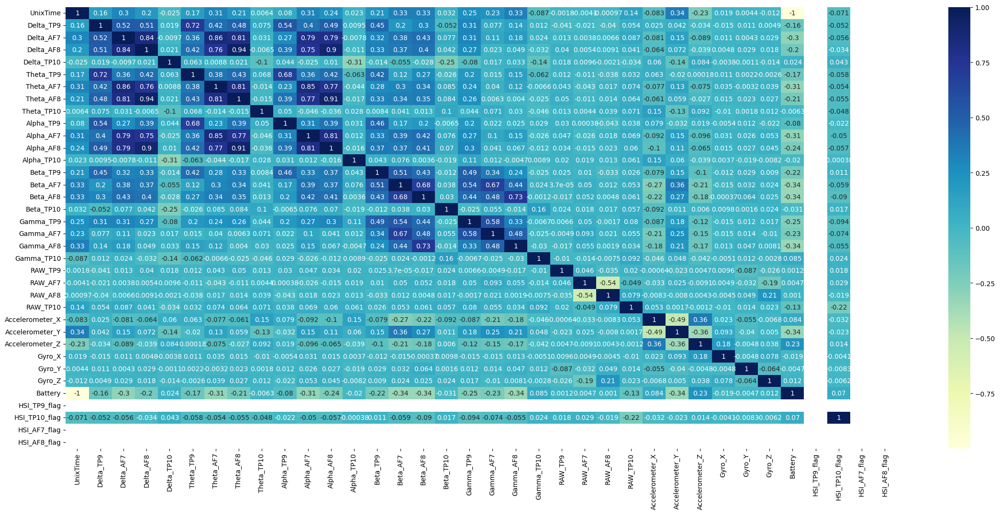

In [46]:
plt.figure(figsize=(28,12))
sns.heatmap(df_1_EEG.corr(numeric_only=True), cmap='YlGnBu', annot=True)
plt.show()

## Notes & Observations

### Dropping RAW EEG Channels

- The EEG dataset includes `RAW_TP9`, `RAW_AF7`, `RAW_AF8`, `RAW_TP10` columns, which represent the unprocessed voltage readings from each electrode.  
- Upon inspection:
  - These RAW signals are **highly noisy** and show no clear oscillatory patterns typical of brainwave activity.  
  - Correlation analysis with other features shows **very low correlations** (near 0.0), indicating they do not contribute predictive value.  
  - Plots of RAW vs. time reveal large fluctuations without meaningful structure.

- Reason for dropping:
  - The dataset already provides **frequency band powers** (`Delta`, `Theta`, `Alpha`, `Beta`, `Gamma`) for each electrode, which are **derived from RAW signals** and are far more informative.  
  - Keeping RAW adds unnecessary dimensionality and noise, which can negatively affect machine learning models.

- Action taken:
  - `RAW_TP9`, `RAW_AF7`, `RAW_AF8`, `RAW_TP10` are **dropped from preprocessing**.  
  - The focus will be on the **precomputed band power features** for all EEG electrodes, which are sufficient for cognitive load prediction and regression tasks.


In [47]:
df_1_EEG.drop(['RAW_TP9',	'RAW_AF7',	'RAW_AF8',	'RAW_TP10'], axis=1, inplace=True)

In [48]:
df_1_EEG.head()

,TimeStamp,UnixTime,QuestionKey,Delta_TP9,Delta_AF7,Delta_AF8,Delta_TP10,Theta_TP9,Theta_AF7,Theta_AF8,Theta_TP10,Alpha_TP9,Alpha_AF7,Alpha_AF8,Alpha_TP10,Beta_TP9,Beta_AF7,Beta_AF8,Beta_TP10,Gamma_TP9,Gamma_AF7,Gamma_AF8,Gamma_TP10,Accelerometer_X,Accelerometer_Y,Accelerometer_Z,Gyro_X,Gyro_Y,Gyro_Z,Battery,HSI_TP9_flag,HSI_TP10_flag,HSI_AF7_flag,HSI_AF8_flag
0,2023-03-28 17:03:16.773,1.680003e+09,None,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.164987,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,92.98,0,0,0,0
1,2023-03-28 17:03:16.776,1.680003e+09,None,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.164987,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,92.98,0,0,0,0
2,2023-03-28 17:03:16.778,1.680003e+09,None,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.164987,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,92.98,0,0,0,0
3,2023-03-28 17:03:16.798,1.680003e+09,None,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.056794,1.217834,0.540305,-0.469205,0.161998,1.294303,-0.041819,-0.939325,-0.100977,1.291504,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,92.98,0,0,0,0
4,2023-03-28 17:03:16.801,1.680003e+09,None,0.558597,-0.100425,0.475775,1.85526,0.509486,-0.135816,-0.222424,0.376283,1.069573,-0.095781,0.056794,1.217834,0.544334,-0.457134,0.153899,1.294303,-0.041819,-0.939325,-0.100977,1.291504,-0.059021,0.151672,0.998169,-0.710297,2.579498,4.42627,92.98,0,0,0,0


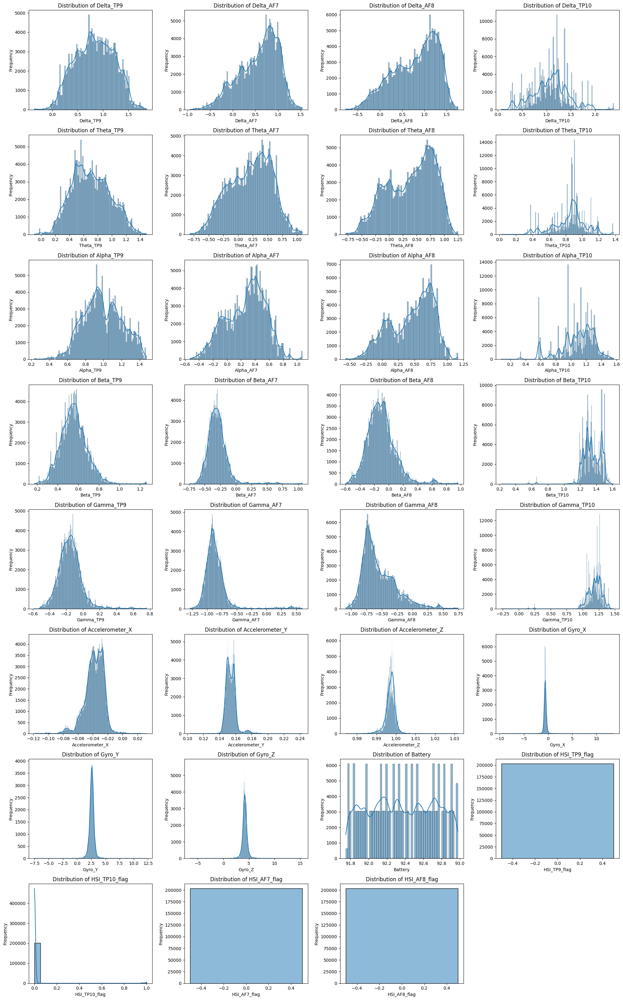

In [49]:
# Select only the numeric columns for plotting histograms, excluding time-related columns
numeric_cols = df_1_EEG.select_dtypes(include=np.number).columns
cols_to_plot = [col for col in numeric_cols if col not in ['UnixTime']]

# Calculate the number of rows and columns for the grid
n_cols = 4  # You can adjust the number of columns as needed
n_rows = (len(cols_to_plot) + n_cols - 1) // n_cols

plt.figure(figsize=(n_cols * 5, n_rows * 4)) # Adjust figure size as needed

for i, col in enumerate(cols_to_plot):
    plt.subplot(n_rows, n_cols, i + 1)
    sns.histplot(df_1_EEG[col], kde=True)
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

In [50]:
plt.figure(figsize=(28,12))
sns.pairplot(df_1_EEG)
plt.show()

<Figure size 2800x1200 with 0 Axes>

## **2_EEG**